#Classification project

This project will provide overview of Explanatory Data Analysis (EDA) on data from Taiwan banking institutions, with focus on predicting which clients will default on their payments. Data is taken from UCI Dataset repository [Default of credit card clients](https://archive.ics.uci.edu/dataset/350/default+of+credit+card+clients)

 Classification models used in this project are:

- Logistic regression
- Suppor Vector Classifier
- RandomForestClassifier
- DecisionTreeClassifier
- KNeighborsClassifier

##**PROJECT**

Importing of all needed packages

In [ ]:
# Import / install relevant Python packages
import numpy as np
from numpy import where
import pandas as pd
from pandas import set_option
import datetime as dt
import statsmodels.api as sm
from scipy.stats import (randint, loguniform)

from collections import Counter

from sklearn.datasets import make_blobs
from sklearn.datasets import make_multilabel_classification

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline

from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import (RFE, SelectFromModel)
from sklearn.model_selection import (KFold, GridSearchCV, RandomizedSearchCV, cross_val_score)
from sklearn import metrics
from sklearn.metrics import (classification_report, confusion_matrix)
from sklearn.svm import (SVC, LinearSVC)
from sklearn.calibration import CalibratedClassifierCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import (DecisionTreeClassifier, plot_tree)
from sklearn.ensemble import RandomForestClassifier

import matplotlib.pyplot as plt
from matplotlib.gridspec import GridSpec
plt.style.use('ggplot')
import seaborn as sns
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, classification_report
from sklearn.calibration import CalibratedClassifierCV
from sklearn.metrics import precision_score, recall_score, f1_score, accuracy_score


###Data preprocessing


In [ ]:
# Import data and print first five observations
df = pd.read_csv('cc_dataset.csv',skiprows=1)
df.head(5)

,ID,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,1,20000,2,2,1,24,2,2,-1,-1,...,0,0,0,0,689,0,0,0,0,1
1,2,120000,2,2,2,26,-1,2,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,3,90000,2,2,2,34,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,4,50000,2,2,1,37,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,5,50000,1,2,1,57,-1,0,-1,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0


Creating a copy of original dataset for future comparison with feature engineered data.

In [ ]:
df_temp = df.copy()

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 25 columns):
 #   Column                      Non-Null Count  Dtype
---  ------                      --------------  -----
 0   ID                          30000 non-null  int64
 1   LIMIT_BAL                   30000 non-null  int64
 2   SEX                         30000 non-null  int64
 3   EDUCATION                   30000 non-null  int64
 4   MARRIAGE                    30000 non-null  int64
 5   AGE                         30000 non-null  int64
 6   PAY_0                       30000 non-null  int64
 7   PAY_2                       30000 non-null  int64
 8   PAY_3                       30000 non-null  int64
 9   PAY_4                       30000 non-null  int64
 10  PAY_5                       30000 non-null  int64
 11  PAY_6                       30000 non-null  int64
 12  BILL_AMT1                   30000 non-null  int64
 13  BILL_AMT2                   30000 non-null  int64
 14  BILL_A

In [ ]:
df.drop('ID',axis=1,inplace=True)
df

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,default payment next month
0,20000,2,2,1,24,2,2,-1,-1,-2,...,0,0,0,0,689,0,0,0,0,1
1,120000,2,2,2,26,-1,2,0,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,90000,2,2,2,34,0,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,50000,2,2,1,37,0,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,50000,1,2,1,57,-1,0,-1,0,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,220000,1,3,1,39,0,0,0,0,0,...,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29996,150000,1,3,2,43,-1,-1,-1,-1,0,...,8979,5190,0,1837,3526,8998,129,0,0,0
29997,30000,1,2,2,37,4,3,2,-1,0,...,20878,20582,19357,0,0,22000,4200,2000,3100,1
29998,80000,1,3,1,41,1,-1,0,0,0,...,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


In [ ]:
df.rename(columns={'default payment next month':'DEFAULT'}, inplace=True)
df

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,...,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,DEFAULT
0,20000,2,2,1,24,2,2,-1,-1,-2,...,0,0,0,0,689,0,0,0,0,1
1,120000,2,2,2,26,-1,2,0,0,0,...,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,90000,2,2,2,34,0,0,0,0,0,...,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,50000,2,2,1,37,0,0,0,0,0,...,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,50000,1,2,1,57,-1,0,-1,0,0,...,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,220000,1,3,1,39,0,0,0,0,0,...,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29996,150000,1,3,2,43,-1,-1,-1,-1,0,...,8979,5190,0,1837,3526,8998,129,0,0,0
29997,30000,1,2,2,37,4,3,2,-1,0,...,20878,20582,19357,0,0,22000,4200,2000,3100,1
29998,80000,1,3,1,41,1,-1,0,0,0,...,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


In [ ]:
df_temp.rename(columns={'default payment next month':'DEFAULT'}, inplace=True)
df_temp.drop('ID',axis=1,inplace=True)


In [ ]:
 pd.set_option('display.max_columns', None)

In [ ]:
df

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,DEFAULT
0,20000,2,2,1,24,2,2,-1,-1,-2,-2,3913,3102,689,0,0,0,0,689,0,0,0,0,1
1,120000,2,2,2,26,-1,2,0,0,0,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1
2,90000,2,2,2,34,0,0,0,0,0,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0
3,50000,2,2,1,37,0,0,0,0,0,0,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0
4,50000,1,2,1,57,-1,0,-1,0,0,0,8617,5670,35835,20940,19146,19131,2000,36681,10000,9000,689,679,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,220000,1,3,1,39,0,0,0,0,0,0,188948,192815,208365,88004,31237,15980,8500,20000,5003,3047,5000,1000,0
29996,150000,1,3,2,43,-1,-1,-1,-1,0,0,1683,1828,3502,8979,5190,0,1837,3526,8998,129,0,0,0
29997,30000,1,2,2,37,4,3,2,-1,0,0,3565,3356,2758,20878,20582,19357,0,0,22000,4200,2000,3100,1
29998,80000,1,3,1,41,1,-1,0,0,0,-1,-1645,78379,76304,52774,11855,48944,85900,3409,1178,1926,52964,1804,1


In [ ]:
# EDA: Print unique values for selected features
print('Gender (1 = male; 2 = female):')
print(sorted(df['SEX'].unique()))
print('-'*100)
print('Education (1 = graduate school; 2 = university; 3 = high school; 4 = others):')
print(sorted(df['EDUCATION'].unique()))
print('-'*100)
print('Marital status (1 = married; 2 = single; 3 = others):')
print(sorted(df['MARRIAGE'].unique()))
print('-'*100)
print('Payment status (-1 = pay duly; K = payment delay for K months, for K=1,2,...,8; 9 = payment delay for nine months and above):')
print(sorted(df['PAY_0'].unique()))
print(sorted(df['PAY_2'].unique()))
print(sorted(df['PAY_3'].unique()))
print(sorted(df['PAY_4'].unique()))
print(sorted(df['PAY_5'].unique()))
print(sorted(df['PAY_6'].unique()))
print('-'*100)

Gender (1 = male; 2 = female):
[1, 2]
----------------------------------------------------------------------------------------------------
Education (1 = graduate school; 2 = university; 3 = high school; 4 = others):
[0, 1, 2, 3, 4, 5, 6]
----------------------------------------------------------------------------------------------------
Marital status (1 = married; 2 = single; 3 = others):
[0, 1, 2, 3]
----------------------------------------------------------------------------------------------------
Payment status (-1 = pay duly; K = payment delay for K months, for K=1,2,...,8; 9 = payment delay for nine months and above):
[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8]
[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8]
[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8]
[-2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8]
[-2, -1, 0, 2, 3, 4, 5, 6, 7, 8]
[-2, -1, 0, 2, 3, 4, 5, 6, 7, 8]
----------------------------------------------------------------------------------------------------


In [ ]:
# EDA: Correct the encoding for the variable EDUCATION
df['EDUCATION']=np.where(df['EDUCATION'] == 5, 4, df['EDUCATION'])
df['EDUCATION']=np.where(df['EDUCATION'] == 6, 4, df['EDUCATION'])
df['EDUCATION']=np.where(df['EDUCATION'] == 0, 4, df['EDUCATION'])

In [ ]:
# EDA: Correct the encoding for the variable MARRIAGE
df['MARRIAGE']=np.where(df['MARRIAGE'] == 0, 3, df['MARRIAGE'])

In [ ]:
# EDA: Print unique values for selected variables
print('Education (1 = graduate school; 2 = university; 3 = high school; 4 = others):')
print(sorted(df['EDUCATION'].unique()))
print('-'*100)
print('Marital status (1 = married; 2 = single; 3 = others):')
print(sorted(df['MARRIAGE'].unique()))
print('-'*100)

Education (1 = graduate school; 2 = university; 3 = high school; 4 = others):
[1, 2, 3, 4]
----------------------------------------------------------------------------------------------------
Marital status (1 = married; 2 = single; 3 = others):
[1, 2, 3]
----------------------------------------------------------------------------------------------------


In [ ]:
# EDA: Working on second dataframe
df_temp['EDUCATION']=np.where(df_temp['EDUCATION'] == 5, 4, df_temp['EDUCATION'])
df_temp['EDUCATION']=np.where(df_temp['EDUCATION'] == 6, 4, df_temp['EDUCATION'])
df_temp['EDUCATION']=np.where(df_temp['EDUCATION'] == 0, 4, df_temp['EDUCATION'])
df_temp['MARRIAGE']=np.where(df_temp['MARRIAGE'] == 0, 3, df_temp['MARRIAGE'])

In [ ]:
df.query('PAY_0 ==-2').T

9       23      33      34      45      52      55      65     \
LIMIT_BAL  20000  450000  500000  500000  210000  310000  500000  200000   
SEX            1       2       2       1       1       2       2       1   
EDUCATION      3       1       2       1       1       2       1       1   
MARRIAGE       2       1       1       1       2       1       1       1   
AGE           35      40      54      58      29      49      45      57   
PAY_0         -2      -2      -2      -2      -2      -2      -2      -2   
PAY_2         -2      -2      -2      -2      -2      -2      -2      -2   
PAY_3         -2      -2      -2      -2      -2      -2      -2      -2   
PAY_4         -2      -2      -2      -2      -2      -2      -2      -1   
PAY_5         -1      -2      -2      -2      -2      -2      -2       2   
PAY_6         -1      -2      -2      -2      -2      -2      -2       2   
BILL_AMT1      0    5512   10929   13709       0   13465    1905  152519   
BILL_AMT2      0   19420    4152    5006       0    7867    3640  148751   
BILL_AMT3      0    1473   22722   31130       0    7600     162  144076   
BILL_AMT4      0     560    7521    3180       0   11185       0    8174   
BILL_AMT5  13007       0   71439       0       0    3544     151    8198   
BILL_AMT6  13912       0    8981    5293       0     464    2530    7918   
PAY_AMT1       0   19428    4152    5006       0    7875    3640       0   
PAY_AMT2       0    1473   22827   31178       0    7600     162       0   
PAY_AMT3       0     560    7521    3180       0   11185       0    8222   
PAY_AMT4   13007       0   71439       0       0    3544     151     300   
PAY_AMT5    1122       0     981    5293       0     464    2530       0   
PAY_AMT6       0    1128   51582     768       0       0       0    1000   
DEFAULT        0       1       0       0       1       0       0       1   

            92      100     101     143     166    176     196     198    \
LIMIT_BAL  100000  140000  380000  170000  370000  80000  150000  500000   
SEX             2       1       2       1       1      1       2       2   
EDUCATION       1       1       1       2       1      1       2       1   
MARRIAGE        2       2       2       2       2      2       1       1   
AGE            27      32      30      29      50     30      34      34   
PAY_0          -2      -2      -2      -2      -2     -2      -2      -2   
PAY_2          -2      -2      -2      -2      -2     -1      -2      -2   
PAY_3          -2      -2      -1      -2      -2      0      -2      -2   
PAY_4          -2      -2       0      -2      -2      0      -2      -1   
PAY_5          -2      -2       0      -2      -2      0      -2      -1   
PAY_6          -2      -2       0      -2      -2      0      -2      -1   
BILL_AMT1   -2000     672     -81   12159    6093   6187       0     412   
BILL_AMT2    5555   10212    -303   10000   15130    100       0     138   
BILL_AMT3       0     850   32475   10000    8204    600       0    2299   
BILL_AMT4       0     415   32891   10000   15398   1438     116    1251   
BILL_AMT5       0     100   33564    9983    4792   1919       0    1206   
BILL_AMT6       0    1430   34056   15846   13453   5380    1500    1151   
PAY_AMT1     7555   10212     223   10000   15383    504       0     138   
PAY_AMT2        0     850   33178   10000    8204    500       0    2299   
PAY_AMT3        0     415    1171   10000   15413   1000     116    1251   
PAY_AMT4        0     100    1197    9983    4792    500       0    1206   
PAY_AMT5        0    1430    1250   15863   13453   3500    1500    1151   
PAY_AMT6        0       0    5000   10000    4699      0       0   15816   
DEFAULT         0       0       0       0       0      0       0       0   

            200     237     263     274     301     305     328     337    \
LIMIT_BAL  180000  210000  230000  360000  440000  110000  340000  140000   
SEX             2       2       2       2       2      

After observation of payment patterns where PAY columns has -2 value, conclusion is that there are no explanation of some unique pattern of credit card holder. Those cases won't be merged with case when PAY columns has -1 value. Those observations will be dropped instead. I won't perform this operation for second, full dataframe.

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 24 columns):
 #   Column     Non-Null Count  Dtype
---  ------     --------------  -----
 0   LIMIT_BAL  30000 non-null  int64
 1   SEX        30000 non-null  int64
 2   EDUCATION  30000 non-null  int64
 3   MARRIAGE   30000 non-null  int64
 4   AGE        30000 non-null  int64
 5   PAY_0      30000 non-null  int64
 6   PAY_2      30000 non-null  int64
 7   PAY_3      30000 non-null  int64
 8   PAY_4      30000 non-null  int64
 9   PAY_5      30000 non-null  int64
 10  PAY_6      30000 non-null  int64
 11  BILL_AMT1  30000 non-null  int64
 12  BILL_AMT2  30000 non-null  int64
 13  BILL_AMT3  30000 non-null  int64
 14  BILL_AMT4  30000 non-null  int64
 15  BILL_AMT5  30000 non-null  int64
 16  BILL_AMT6  30000 non-null  int64
 17  PAY_AMT1   30000 non-null  int64
 18  PAY_AMT2   30000 non-null  int64
 19  PAY_AMT3   30000 non-null  int64
 20  PAY_AMT4   30000 non-null  int64
 21  PAY_AMT5   3

In [ ]:
df.drop(df[df['PAY_0'] == -2].index, inplace=True)
df.drop(df[df['PAY_2'] == -2].index, inplace=True)
df.drop(df[df['PAY_3'] == -2].index, inplace=True)
df.drop(df[df['PAY_4'] == -2].index, inplace=True)
df.drop(df[df['PAY_5'] == -2].index, inplace=True)
df.drop(df[df['PAY_6'] == -2].index, inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23439 entries, 1 to 29999
Data columns (total 24 columns):
 #   Column     Non-Null Count  Dtype
---  ------     --------------  -----
 0   LIMIT_BAL  23439 non-null  int64
 1   SEX        23439 non-null  int64
 2   EDUCATION  23439 non-null  int64
 3   MARRIAGE   23439 non-null  int64
 4   AGE        23439 non-null  int64
 5   PAY_0      23439 non-null  int64
 6   PAY_2      23439 non-null  int64
 7   PAY_3      23439 non-null  int64
 8   PAY_4      23439 non-null  int64
 9   PAY_5      23439 non-null  int64
 10  PAY_6      23439 non-null  int64
 11  BILL_AMT1  23439 non-null  int64
 12  BILL_AMT2  23439 non-null  int64
 13  BILL_AMT3  23439 non-null  int64
 14  BILL_AMT4  23439 non-null  int64
 15  BILL_AMT5  23439 non-null  int64
 16  BILL_AMT6  23439 non-null  int64
 17  PAY_AMT1   23439 non-null  int64
 18  PAY_AMT2   23439 non-null  int64
 19  PAY_AMT3   23439 non-null  int64
 20  PAY_AMT4   23439 non-null  int64
 21  PAY_AMT5   2

In [ ]:
23439/29999

0.7813260442014733

After data removal, 23439 observations are left. That is 78% of initial dataset. Classification metrics will be later compared between full dataset and this clipped dataset.

In [ ]:
df.query('PAY_0 ==0').T

,2,3,5,6,7,8,10,14,16,17,20,24,25,27,29,32,36,37,40,41,42,43,44,46,49,51,56,57,59,60,61,75,78,80,81,82,83,84,85,87,88,94,95,97,98,99,102,103,108,110,111,113,114,119,124,126,127,128,132,133,134,135,136,137,139,145,146,150,151,153,154,155,156,157,163,164,165,168,169,170,178,179,181,182,183,184,190,194,197,201,203,204,208,210,212,213,218,221,222,223,225,227,230,234,236,238,239,241,242,246,247,248,249,251,252,253,255,256,260,261,266,267,268,270,273,275,278,279,281,282,283,284,287,289,293,295,297,298,300,302,303,311,312,314,315,316,321,324,331,334,335,336,338,341,343,344,347,348,349,350,353,356,357,358,361,366,372,373,374,375,378,379,380,382,385,388,392,393,395,396,398,400,401,403,408,409,417,418,421,424,428,429,430,431,432,433,437,438,439,441,443,444,445,446,448,449,452,454,455,459,460,462,463,466,467,468,470,471,475,476,477,480,481,482,485,487,492,494,496,497,499,500,502,503,507,508,514,515,516,517,519,520,523,524,530,531,532,536,537,543,545,549,550,552,557,559,566,568,571,578,583,584,585,588,590,591,592,593,594,595,596,600,602,607,610,612,615,617,618,619,620,625,626,628,631,634,636,637,639,640,642,643,644,647,651,652,654,656,657,658,661,663,664,665,666,667,671,674,677,680,683,684,687,688,689,690,693,696,699,708,709,710,711,715,716,717,719,720,721,724,725,728,730,731,734,736,737,738,740,742,743,745,746,747,752,755,756,758,759,764,766,772,773,780,784,788,794,795,799,807,808,809,810,815,819,823,824,827,829,832,837,838,841,844,850,853,854,856,858,859,863,864,865,868,869,870,871,875,876,878,882,883,884,885,888,889,893,898,902,907,908,909,912,913,914,916,918,919,921,922,924,926,927,930,934,936,940,945,946,947,948,951,955,956,962,964,965,968,969,971,974,975,978,980,983,990,992,996,1000,1001,1007,1008,1010,1013,1015,1016,1020,1021,1025,1026,1033,1036,1037,1038,1042,1043,1045,1046,1049,1051,1052,1053,1055,1057,1058,1060,1061,1062,1063,1065,1066,1069,1075,1076,1080,1085,1086,1088,1089,1090,1091,1095,1099,1101,1102,1108,1112,1113,1114,1116,1122,1123,1129,1130,1135,1137,1138,1139,1141,1163,1166,1167,1169,1170,1174,1176,1177,1178,1179,1183,1184,1188,1189,1193,1194,1196,1198,1200,1201,1202,1204,1205,1207,1208,1210,1213,1215,1217,1218,1219,1220,1228,1229,1230,1231,1232,1234,1235,1238,1244,1248,1250,1252,1253,1254,1260,1261,1262,1264,1265,1266,1269,1270,1274,1277,1278,1280,1282,1284,1285,1286,1289,1291,1293,1294,1295,1298,1301,1302,1304,1308,1309,1312,1313,1317,1321,1322,1324,1326,1327,1328,1329,1331,1335,1346,1347,1352,1353,1354,1355,1356,1358,1359,1364,1365,1367,1371,1373,1376,1378,1380,1381,1382,1384,1388,1389,1392,1393,1397,1399,1400,1402,1407,1408,1415,1418,1420,1421,1422,1424,1429,1430,1433,1436,1437,1439,1440,1441,1448,1449,1450,1453,1454,1455,1456,1459,1461,1462,1465,1470,1472,1474,1475,1477,1480,1482,1484,1486,1487,1489,1490,1491,1494,1497,1500,1503,1504,1505,1508,1510,1512,1514,1516,1519,1522,1526,1527,1532,1533,1534,1539,1542,1547,1549,1550,1551,1552,1556,1559,1560,1562,1563,1564,1565,1566,1567,1572,1573,1575,1577,1580,1581,1582,1584,1585,1587,1590,1592,1597,1599,1602,1609,1610,1612,1614,1618,1619,1621,1622,1624,1626,1627,1629,1630,1632,1634,1635,1636,1642,1645,1647,1649,1654,1656,1657,1659,1669,1670,1675,1677,1679,1681,1682,1684,1686,1687,1688,1693,1694,1700,1701,1702,1704,1705,1707,1710,1713,1715,1716,1720,1721,1724,1725,1728,1731,1732,1733,1737,1738,1739,1740,1745,1747,1749,1750,1753,1754,1755,1756,1758,1765,1767,1771,1777,1778,1779,1781,1782,1784,1786,1789,1791,1792,1796,1797,1799,1806,1807,1808,1811,1812,1814,1815,1819,1821,1823,1826,1827,1830,1832,1833,1836,1837,1838,1840,1842,1846,1851,1852,1854,1857,1858,1859,1862,1863,1865,1867,1870,1871,1872,1873,1876,1877,1880,1882,1883,1886,1887,1890,1896,1897,1898,1900,1903,1904,1905,1909,1912,1913,1915,1917,1918,1922,1923,1924,1925,1926,1927,1928,1929,1930,1935,1937,1938,1939,1942,1943,1946,1947,1948,1949,1950,1951,1952,1953,1957,1959,1962,1963,1967,1970,1972,1975,1976,1979,1982,1984,1986,1989,1990,1994,1996,1997,1998,1999,2000,2001,2004,2006,2010,2011,2017,2018,2020,2021,2024,2026,2027

After observation of payment patterns where PAY columns has 0 value, it can concluded that there is assumption that the client is paying on regular basis, but with minimal ammounts. In banking terms, those clients are not registered as clients with delayed payment, and for them default interest is not applicable.




In [ ]:
all_male = df[(df['SEX'] == 1)]
all_male_default = df[(df['SEX'] == 1) & (df['DEFAULT'] ==1)]
all_male_non_default = df[(df['SEX'] == 1) & (df['DEFAULT'] ==0)]

n_male = len(all_male)
n_male_default = len(all_male_default)
n_male_non_default = len(all_male_non_default)

male_non_def = round(n_male_non_default/n_male,2) * 100
male_def = round(n_male_default/n_male,2) * 100


all_female = df[(df['SEX'] == 2)]
all_female_defalt = df[(df['SEX'] == 2) & (df['DEFAULT'] ==1)]
all_female_non_defalt = df[(df['SEX'] == 2) & (df['DEFAULT'] ==0)]


n_female = len(all_female)
n_female_default = len(all_female_defalt)
n_female_non_default = len(all_female_non_defalt)

female_non_def = round(n_female_non_default/n_female,2) * 100
female_def = round(n_female_default/n_female,2) * 100

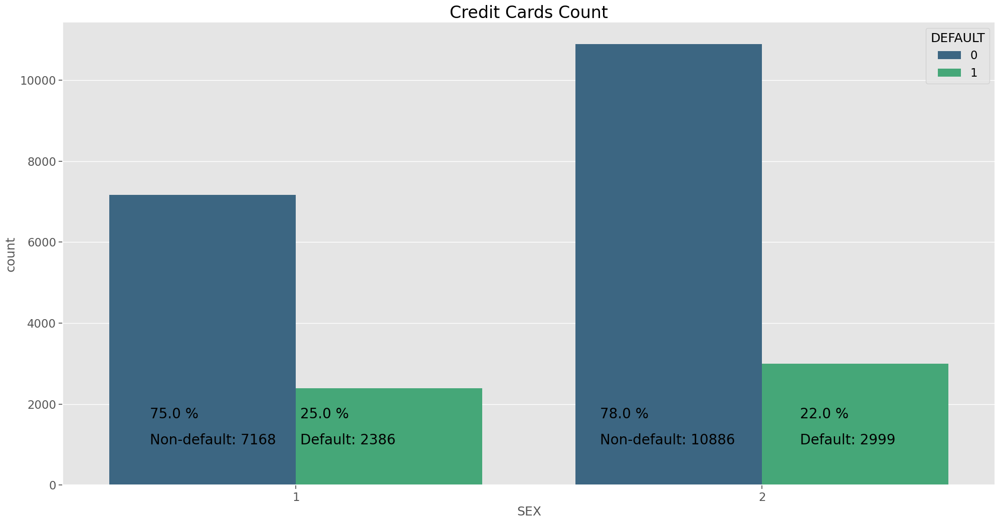

In [ ]:
# EDA: Plot count of male and female in respect of default clients
plt.figure(figsize=(24,12))

sns.set_context('notebook', font_scale=1.5)

sns.countplot(x='SEX', hue='DEFAULT', data=df, palette='viridis', )
plt.title('Credit Cards Count', size=24)
plt.annotate('Non-default: {}'.format(n_male_non_default), xycoords = 'subfigure fraction', xy=(0.2, 0.15), xytext=(0.15, 0.15), size=20)
plt.annotate('Default: {}'.format(n_male_default), xycoords = 'subfigure fraction', xy=(0.3, 0.15), xytext=(0.3, 0.15), size=20)
plt.annotate('Non-default: {}'.format(n_female_non_default), xycoords = 'subfigure fraction', xy=(0.4, 0.15), xytext=(0.6, 0.15), size=20)
plt.annotate('Default: {}'.format(n_female_default), xycoords = 'subfigure fraction', xy=(0.5, 0.15), xytext=(0.8, 0.15), size=20)
plt.annotate(str(male_non_def)+ ' %', xycoords = 'subfigure fraction',  xy=(0.2, 0.15), xytext=(0.15, 0.2), size=20)
plt.annotate(str(male_def)+' %', xycoords = 'subfigure fraction', xy=(0.3, 0.15), xytext=(0.3, 0.2), size=20)
plt.annotate(str(female_non_def)+' %', xycoords = 'subfigure fraction', xy=(0.4, 0.15), xytext=(0.6, 0.2), size=20)
plt.annotate(str(female_def)+' %', xycoords = 'subfigure fraction', xy=(0.5, 0.15), xytext=(0.8, 0.2), size=20)
plt.show()


On percentage basis, male clients are more likely to default on their payments.

In [ ]:
df['MALE_STATUS'] = np.where((df['SEX'] == 1) & (df['MARRIAGE'] == 1), 1,
                             np.where((df['SEX'] == 1) & (df['MARRIAGE'] == 2), 2,
                                      np.where((df['SEX'] == 1) & (df['MARRIAGE'] == 3), 3, 0)))

In [ ]:
df['FEMALE_STATUS'] = np.where((df['SEX'] == 2) & (df['MARRIAGE'] == 1), 1,
                             np.where((df['SEX'] == 2) & (df['MARRIAGE'] == 2), 2,
                                      np.where((df['SEX'] == 2) & (df['MARRIAGE'] == 3), 3, 0)))

In [ ]:
#Single males
all_single_male = df[(df['MALE_STATUS'] == 1)]
all_single_male_default = df[(df['MALE_STATUS'] == 1) & (df['DEFAULT'] ==1)]
all_single_male_non_default = df[(df['MALE_STATUS'] == 1) & (df['DEFAULT'] ==0)]

n_single_male = len(all_single_male)
n_single_male_default = len(all_single_male_default)
n_single_male_non_default = len(all_single_male_non_default)

single_male_non_def = round(n_single_male_non_default/n_single_male,2) * 100
single_male_def = round(n_single_male_default/n_single_male,2) * 100

#Married males
all_married_male = df[(df['MALE_STATUS'] == 2)]
all_married_male_defalt = df[(df['MALE_STATUS'] == 2) & (df['DEFAULT'] ==1)]
all_married_male_non_defalt = df[(df['MALE_STATUS'] == 2) & (df['DEFAULT'] ==0)]


n_married_male = len(all_married_male)
n_married_male_default = len(all_married_male_defalt)
n_married_male_non_default = len(all_married_male_non_defalt)

married_male_non_def = round(n_married_male_non_default/n_married_male,2) * 100
married_male_def = round(n_married_male_default/n_married_male,2) * 100

#Other males
all_other_male = df[(df['MALE_STATUS'] == 3)]
all_other_male_defalt = df[(df['MALE_STATUS'] == 3) & (df['DEFAULT'] ==1)]
all_other_male_non_defalt = df[(df['MALE_STATUS'] == 3) & (df['DEFAULT'] ==0)]


n_other_male = len(all_other_male)
n_other_male_default = len(all_other_male_defalt)
n_other_male_non_default = len(all_other_male_non_defalt)

other_male_non_def = round(n_other_male_non_default/n_other_male,2) * 100
other_male_def = round((n_other_male_default/n_other_male),2) * 100


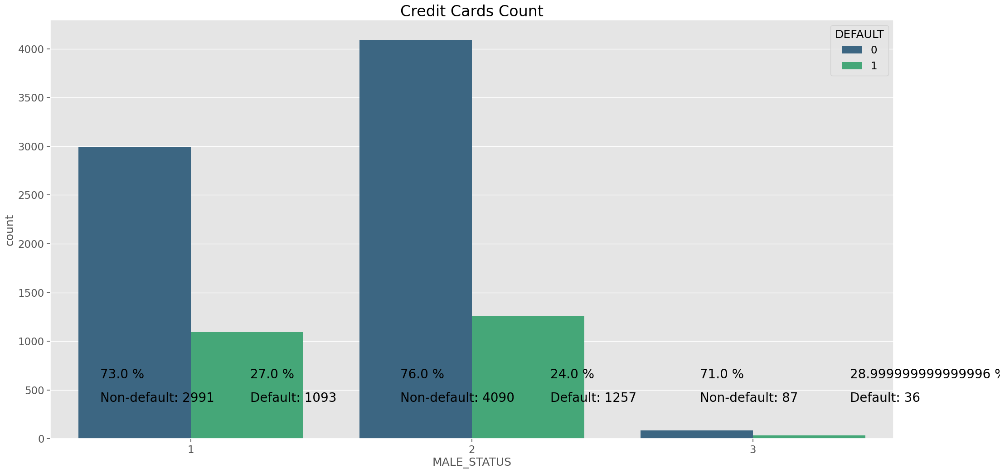

In [ ]:
# EDA: Plot count of single and married males in respect of default clients
plt.figure(figsize=(24,12))
filtered_df_male = df[df['MALE_STATUS'] != 0]

sns.set_context('notebook', font_scale=1.5)
sns.countplot(x='MALE_STATUS', hue='DEFAULT', data=filtered_df_male, palette='viridis', )
plt.title('Credit Cards Count', size=24)
plt.annotate('Non-default: {}'.format(n_single_male_non_default), xycoords = 'subfigure fraction', xy=(0.3, 0.15), xytext=(0.1, 0.15), size=20)
plt.annotate('Default: {}'.format(n_single_male_default), xycoords = 'subfigure fraction', xy=(0.3, 0.15), xytext=(0.25, 0.15), size=20)
plt.annotate('Non-default: {}'.format(n_married_male_non_default), xycoords = 'subfigure fraction', xy=(0.4, 0.15), xytext=(0.4, 0.15), size=20)
plt.annotate('Default: {}'.format(n_married_male_default), xycoords = 'subfigure fraction', xy=(0.5, 0.15), xytext=(0.55, 0.15), size=20)
plt.annotate('Non-default: {}'.format(n_other_male_non_default), xycoords = 'subfigure fraction', xy=(0.4, 0.15), xytext=(0.7, 0.15), size=20)
plt.annotate('Default: {}'.format(n_other_male_default), xycoords = 'subfigure fraction', xy=(0.5, 0.15), xytext=(0.85, 0.15), size=20)
plt.annotate(str(single_male_non_def)+ ' %', xycoords = 'subfigure fraction',  xy=(0.2, 0.15), xytext=(0.1, 0.2), size=20)
plt.annotate(str(single_male_def)+' %', xycoords = 'subfigure fraction', xy=(0.3, 0.15), xytext=(0.25, 0.2), size=20)
plt.annotate(str(married_male_non_def)+' %', xycoords = 'subfigure fraction', xy=(0.4, 0.15), xytext=(0.4, 0.2), size=20)
plt.annotate(str(married_male_def)+' %', xycoords = 'subfigure fraction', xy=(0.5, 0.15), xytext=(0.55, 0.2), size=20)
plt.annotate(str(other_male_non_def)+' %', xycoords = 'subfigure fraction', xy=(0.4, 0.15), xytext=(0.7, 0.2), size=20)
plt.annotate(str(other_male_def)+' %', xycoords = 'subfigure fraction', xy=(0.5, 0.15), xytext=(0.85, 0.2), size=20)
plt.show()


Data show there is a slight higher relative number of married males that default in respect to single male. Interesting observation is that clients that are in 'other' group in their marital status have higher relative number of defaults. The problem is that group of those males are to small to draw any impactful conclusion.

In [ ]:
#Single females
all_single_female = df[(df['FEMALE_STATUS'] == 1)]
all_single_female_default = df[(df['FEMALE_STATUS'] == 1) & (df['DEFAULT'] ==1)]
all_single_female_non_default = df[(df['FEMALE_STATUS'] == 1) & (df['DEFAULT'] ==0)]

n_single_female = len(all_single_female)
n_single_female_default = len(all_single_female_default)
n_single_female_non_default = len(all_single_female_non_default)

single_female_non_def = round(n_single_female_non_default/n_single_female,2) * 100
single_female_def = round(n_single_female_default/n_single_female,2) * 100

#Married females
all_married_female = df[(df['FEMALE_STATUS'] == 2)]
all_married_female_defalt = df[(df['FEMALE_STATUS'] == 2) & (df['DEFAULT'] ==1)]
all_married_female_non_defalt = df[(df['FEMALE_STATUS'] == 2) & (df['DEFAULT'] ==0)]


n_married_female = len(all_married_female)
n_married_female_default = len(all_married_female_defalt)
n_married_female_non_default = len(all_married_female_non_defalt)

married_female_non_def = round(n_married_female_non_default/n_married_female,2) * 100
married_female_def = round(n_married_female_default/n_married_female,2) * 100

#Other females
all_other_female = df[(df['FEMALE_STATUS'] == 3)]
all_other_female_defalt = df[(df['FEMALE_STATUS'] == 3) & (df['DEFAULT'] ==1)]
all_other_female_non_defalt = df[(df['FEMALE_STATUS'] == 3) & (df['DEFAULT'] ==0)]


n_other_female = len(all_other_female)
n_other_female_default = len(all_other_female_defalt)
n_other_female_non_default = len(all_other_female_non_defalt)

other_female_non_def = round(n_other_female_non_default/n_other_female,2) * 100
other_female_def = round(n_other_female_default/n_other_female,2) * 100


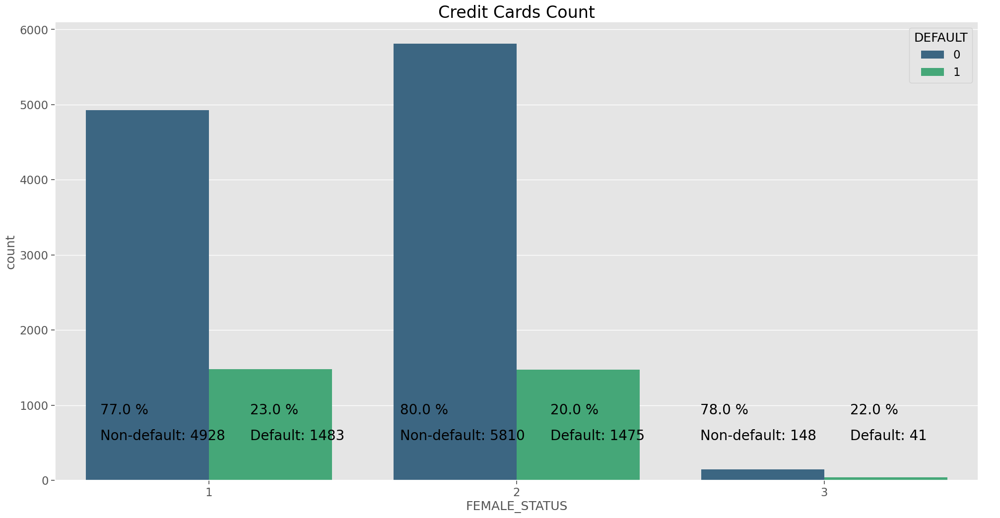

In [ ]:
# EDA: Plot count of single and married females in respect of default clients
plt.figure(figsize=(24,12))
filtered_df_female = df[df['FEMALE_STATUS'] != 0]

sns.set_context('notebook', font_scale=1.5)
sns.countplot(x='FEMALE_STATUS', hue='DEFAULT', data=filtered_df_female, palette='viridis', )
plt.title('Credit Cards Count', size=24)
plt.annotate('Non-default: {}'.format(n_single_female_non_default), xycoords = 'subfigure fraction', xy=(0.3, 0.15), xytext=(0.1, 0.15), size=20)
plt.annotate('Default: {}'.format(n_single_female_default), xycoords = 'subfigure fraction', xy=(0.3, 0.15), xytext=(0.25, 0.15), size=20)
plt.annotate('Non-default: {}'.format(n_married_female_non_default), xycoords = 'subfigure fraction', xy=(0.4, 0.15), xytext=(0.4, 0.15), size=20)
plt.annotate('Default: {}'.format(n_married_female_default), xycoords = 'subfigure fraction', xy=(0.5, 0.15), xytext=(0.55, 0.15), size=20)
plt.annotate('Non-default: {}'.format(n_other_female_non_default), xycoords = 'subfigure fraction', xy=(0.4, 0.15), xytext=(0.7, 0.15), size=20)
plt.annotate('Default: {}'.format(n_other_female_default), xycoords = 'subfigure fraction', xy=(0.5, 0.15), xytext=(0.85, 0.15), size=20)
plt.annotate(str(single_female_non_def)+ ' %', xycoords = 'subfigure fraction',  xy=(0.2, 0.15), xytext=(0.1, 0.2), size=20)
plt.annotate(str(single_female_def)+' %', xycoords = 'subfigure fraction', xy=(0.3, 0.15), xytext=(0.25, 0.2), size=20)
plt.annotate(str(married_female_non_def)+' %', xycoords = 'subfigure fraction', xy=(0.4, 0.15), xytext=(0.4, 0.2), size=20)
plt.annotate(str(married_female_def)+' %', xycoords = 'subfigure fraction', xy=(0.5, 0.15), xytext=(0.55, 0.2), size=20)
plt.annotate(str(other_female_non_def)+' %', xycoords = 'subfigure fraction', xy=(0.4, 0.15), xytext=(0.7, 0.2), size=20)
plt.annotate(str(other_female_def)+' %', xycoords = 'subfigure fraction', xy=(0.5, 0.15), xytext=(0.85, 0.2), size=20)
plt.show()


We can observe similar pattern with females. There is relatively higher number of married female clients that defaults than those that are single.

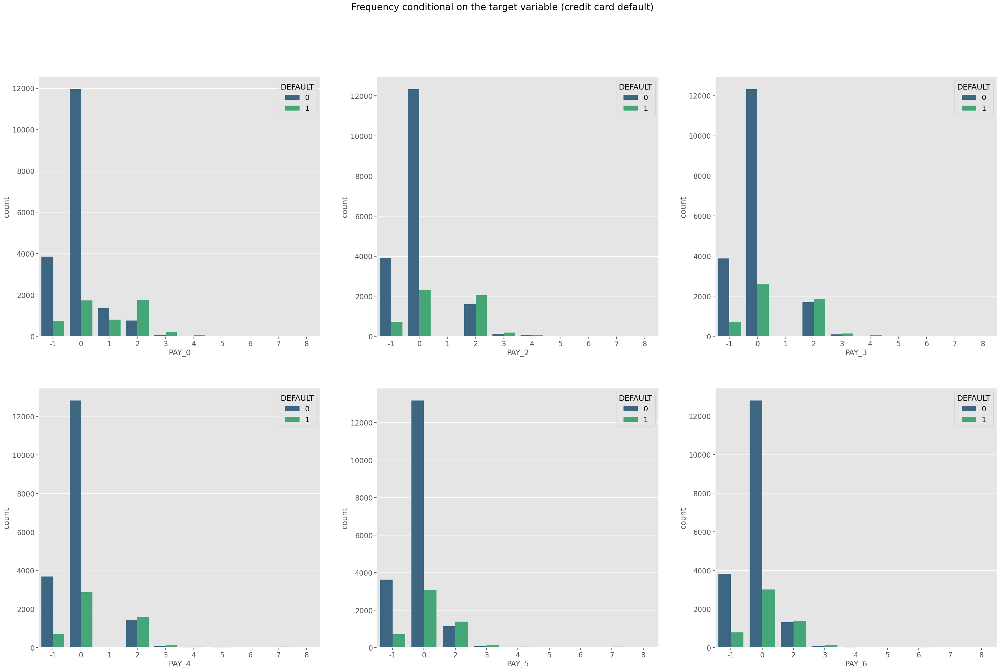

In [ ]:
# EDA: Payments variabes count (conditional on the credit card defaults)
df_cat = df[['PAY_0', 'PAY_2', 'PAY_3', 'PAY_4',
                     'PAY_5', 'PAY_6', 'DEFAULT']]
fig, axes = plt.subplots(2, 3, figsize=(40, 24), facecolor='white')
fig.suptitle('Frequency conditional on the target variable (credit card default)')
ax1 = sns.countplot(x='PAY_0', hue='DEFAULT', data=df, palette='viridis', ax=axes[0,0])
ax2 = sns.countplot(x='PAY_2', hue='DEFAULT', data=df, palette='viridis', ax=axes[0,1])
ax3 = sns.countplot(x='PAY_3', hue='DEFAULT', data=df, palette='viridis', ax=axes[0,2])
ax4 = sns.countplot(x='PAY_4', hue='DEFAULT', data=df, palette='viridis', ax=axes[1,0])
ax5 = sns.countplot(x='PAY_5', hue='DEFAULT', data=df, palette='viridis', ax=axes[1,1])
ax6 = sns.countplot(x='PAY_6', hue='DEFAULT', data=df, palette='viridis', ax=axes[1,2])
plt.show()

In [ ]:
payment_columns=['PAY_0','PAY_2','PAY_3','PAY_4','PAY_5','PAY_6']
df['ALWAYS_LATE_2_OR_MORE_MONTH'] = df[payment_columns].apply(lambda row: 1 if all(value >=2 for value in row) else 0, axis=1)


In [ ]:
df['LATE_ONE_MONTH'] = df[payment_columns].apply(lambda row: 1 if all(value == 1 for value in row) else 0, axis=1)


In [ ]:
df['REGULAR_CLIENT'] = df[payment_columns].apply(lambda row: 1 if all(value in [-1,0] for value in row) else 0, axis=1)


I'll now construct variable "CLIENT_STATUS" that will represent status of client payments.

0 - Client that has undefined structure of his payments.

1 - This is regular client. All of his payments are either dully or he pays its
without any dellay

2 - This is client that is always in late for just one month

3 - This is client that is always late for 2 or more months

In [ ]:
df['CLIENT_STATUS'] = np.where((df['REGULAR_CLIENT'] == 1), 1,
                             np.where((df['LATE_ONE_MONTH'] == 1), 2,
                                      np.where((df['ALWAYS_LATE_2_OR_MORE_MONTH'] == 1), 3, 0)))

I will now drop columns that are included in "CLIENT_STATUS".

In [ ]:
df.drop(columns=['LATE_ONE_MONTH'],axis=1,inplace=True)

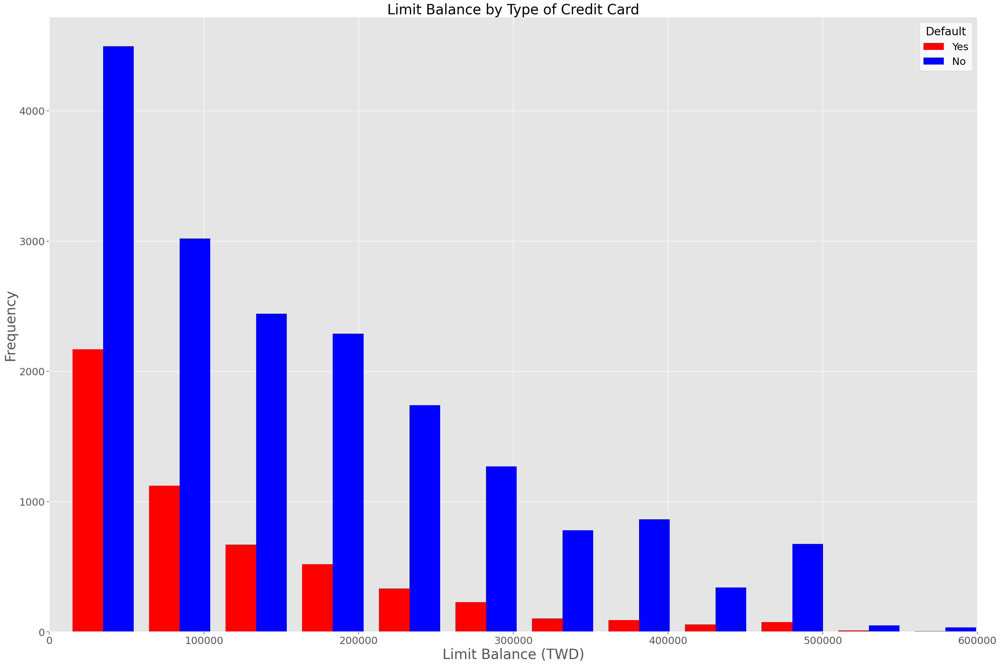

In [ ]:
# EDA: Limit balance distribution (conditional on the credit card defaults)
x1 = list(df[df['DEFAULT'] == 1]['LIMIT_BAL'])
x2 = list(df[df['DEFAULT'] == 0]['LIMIT_BAL'])

plt.figure(figsize=(36,24))
sns.set_context('notebook', font_scale=2)
plt.hist([x1, x2], bins = 20, color=['red', 'blue'])
plt.xlim([0,600000])
plt.legend(['Yes', 'No'], title = 'Default', loc='upper right', facecolor='white')
plt.xlabel('Limit Balance (TWD)', size=30)
plt.ylabel('Frequency', size=30)
plt.title('Limit Balance by Type of Credit Card', size=30)
plt.show()

We can see from the plot that there is the most relative defaults when limit balance is under 100.000. We will now investigate what is the default status when limit balance is less or above 50.000.

In [ ]:
df['LIMIT_BAL_CATEGORY'] = pd.cut(df['LIMIT_BAL'], bins=[-float('inf'), 50000, 100000, float('inf')], labels=[1, 2, 3])


In [ ]:
df

,LIMIT_BAL,SEX,EDUCATION,MARRIAGE,AGE,PAY_0,PAY_2,PAY_3,PAY_4,PAY_5,PAY_6,BILL_AMT1,BILL_AMT2,BILL_AMT3,BILL_AMT4,BILL_AMT5,BILL_AMT6,PAY_AMT1,PAY_AMT2,PAY_AMT3,PAY_AMT4,PAY_AMT5,PAY_AMT6,DEFAULT,MALE_STATUS,FEMALE_STATUS,ALWAYS_LATE_2_OR_MORE_MONTH,REGULAR_CLIENT,CLIENT_STATUS,LIMIT_BAL_CATEGORY
1,120000,2,2,2,26,-1,2,0,0,0,2,2682,1725,2682,3272,3455,3261,0,1000,1000,1000,0,2000,1,0,2,0,0,0,3
2,90000,2,2,2,34,0,0,0,0,0,0,29239,14027,13559,14331,14948,15549,1518,1500,1000,1000,1000,5000,0,0,2,0,1,1,2
3,50000,2,2,1,37,0,0,0,0,0,0,46990,48233,49291,28314,28959,29547,2000,2019,1200,1100,1069,1000,0,0,1,0,1,1,1
4,50000,1,2,1,57,-1,0,-1,0,0,0,8617,5670,35835,20940,19146,19131,2000,36681,10000,9000,689,679,0,1,0,0,1,1,1
5,50000,1,1,2,37,0,0,0,0,0,0,64400,57069,57608,19394,19619,20024,2500,1815,657,1000,1000,800,0,2,0,0,1,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29995,220000,1,3,1,39,0,0,0,0,0,0,188948,192815,208365,88004,31237,15980,8500,20000,5003,3047,5000,1000,0,1,0,0,1,1,3
29996,150000,1,3,2,43,-1,-1,-1,-1,0,0,1683,1828,3502,8979,5190,0,1837,3526,8998,129,0,0,0,2,0,0,1,1,3
29997,30000,1,2,2,37,4,3,2,-1,0,0,3565,3356,2758,20878,20582,19357,0,0,22000,4200,2000,3100,1,2,0,0,0,0,1
29998,80000,1,3,1,41,1,-1,0,0,0,-1,-1645,78379,76304,52774,11855,48944,85900,3409,1178,1926,52964,1804,1,1,0,0,0,0,2


In [ ]:
#Limit balance category under 50.000
all_lower_balance = df[(df['LIMIT_BAL_CATEGORY'] == 1)]
all_lower_balance_default = df[(df['LIMIT_BAL_CATEGORY'] == 1) & (df['DEFAULT'] ==1)]
all_lower_balance_non_default = df[(df['LIMIT_BAL_CATEGORY'] == 1) & (df['DEFAULT'] ==0)]

n_lower_balance = len(all_lower_balance)
n_lower_balance_default = len(all_lower_balance_default)
n_lower_balance_non_default = len(all_lower_balance_non_default)

lower_balance_non_def = round(n_lower_balance_non_default/n_lower_balance,2) * 100
lower_balance_def = round(n_lower_balance_default/n_lower_balance,2) * 100

#Limit balance category between 50.000 and 100.000
all_middle_balance = df[(df['LIMIT_BAL_CATEGORY'] == 2)]
all_middle_balance_default = df[(df['LIMIT_BAL_CATEGORY'] == 2) & (df['DEFAULT'] ==1)]
all_middle_balance_non_default = df[(df['LIMIT_BAL_CATEGORY'] == 2) & (df['DEFAULT'] ==0)]


n_middle_balance = len(all_middle_balance)
n_middle_balance_default = len(all_middle_balance_default)
n_middle_balance_non_default = len(all_middle_balance_non_default)

middle_balance_non_def = round(n_middle_balance_non_default/n_middle_balance,2) * 100
middle_balance_def = round(n_middle_balance_default/n_middle_balance,2) * 100

#Limit balance category above 100.000
all_high_balance = df[(df['LIMIT_BAL_CATEGORY'] == 3)]
all_high_balance_default = df[(df['LIMIT_BAL_CATEGORY'] == 3) & (df['DEFAULT'] ==1)]
all_high_balance_non_default = df[(df['LIMIT_BAL_CATEGORY'] == 3) & (df['DEFAULT'] ==0)]


n_high_balance = len(all_high_balance)
n_high_balance_default = len(all_high_balance_default)
n_high_balance_default_non_default = len(all_high_balance_non_default)

high_balance_non_def = round(n_high_balance_default_non_default/n_high_balance,2) * 100
high_balance_def = round(n_high_balance_default/n_high_balance,2) * 100


In [ ]:
df['LIMIT_BAL_CATEGORY'] = df['LIMIT_BAL_CATEGORY'].astype('int64')
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 23439 entries, 1 to 29999
Data columns (total 30 columns):
 #   Column                       Non-Null Count  Dtype
---  ------                       --------------  -----
 0   LIMIT_BAL                    23439 non-null  int64
 1   SEX                          23439 non-null  int64
 2   EDUCATION                    23439 non-null  int64
 3   MARRIAGE                     23439 non-null  int64
 4   AGE                          23439 non-null  int64
 5   PAY_0                        23439 non-null  int64
 6   PAY_2                        23439 non-null  int64
 7   PAY_3                        23439 non-null  int64
 8   PAY_4                        23439 non-null  int64
 9   PAY_5                        23439 non-null  int64
 10  PAY_6                        23439 non-null  int64
 11  BILL_AMT1                    23439 non-null  int64
 12  BILL_AMT2                    23439 non-null  int64
 13  BILL_AMT3                    23439 non-null  i

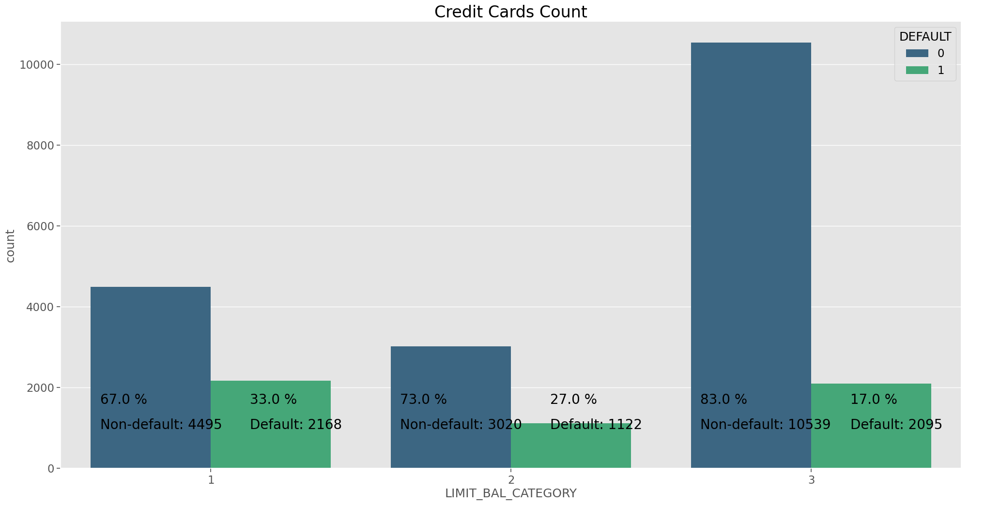

In [ ]:
# EDA: Plot count of Limit Balance category in respect of default clients
plt.figure(figsize=(24,12))

sns.set_context('notebook', font_scale=1.5)
sns.countplot(x='LIMIT_BAL_CATEGORY', hue='DEFAULT', data=df, palette='viridis', )
plt.title('Credit Cards Count', size=24)
plt.annotate('Non-default: {}'.format(n_lower_balance_non_default), xycoords = 'subfigure fraction', xy=(0.3, 0.15), xytext=(0.1, 0.15), size=20)
plt.annotate('Default: {}'.format(n_lower_balance_default), xycoords = 'subfigure fraction', xy=(0.3, 0.15), xytext=(0.25, 0.15), size=20)
plt.annotate('Non-default: {}'.format(n_middle_balance_non_default), xycoords = 'subfigure fraction', xy=(0.4, 0.15), xytext=(0.4, 0.15), size=20)
plt.annotate('Default: {}'.format(n_middle_balance_default), xycoords = 'subfigure fraction', xy=(0.5, 0.15), xytext=(0.55, 0.15), size=20)
plt.annotate('Non-default: {}'.format(n_high_balance_default_non_default), xycoords = 'subfigure fraction', xy=(0.4, 0.15), xytext=(0.7, 0.15), size=20)
plt.annotate('Default: {}'.format(n_high_balance_default), xycoords = 'subfigure fraction', xy=(0.5, 0.15), xytext=(0.85, 0.15), size=20)
plt.annotate(str(lower_balance_non_def)+ ' %', xycoords = 'subfigure fraction',  xy=(0.2, 0.15), xytext=(0.1, 0.2), size=20)
plt.annotate(str(lower_balance_def)+' %', xycoords = 'subfigure fraction', xy=(0.3, 0.15), xytext=(0.25, 0.2), size=20)
plt.annotate(str(middle_balance_non_def)+' %', xycoords = 'subfigure fraction', xy=(0.4, 0.15), xytext=(0.4, 0.2), size=20)
plt.annotate(str(middle_balance_def)+' %', xycoords = 'subfigure fraction', xy=(0.5, 0.15), xytext=(0.55, 0.2), size=20)
plt.annotate(str(high_balance_non_def)+' %', xycoords = 'subfigure fraction', xy=(0.4, 0.15), xytext=(0.7, 0.2), size=20)
plt.annotate(str(high_balance_def)+' %', xycoords = 'subfigure fraction', xy=(0.5, 0.15), xytext=(0.85, 0.2), size=20)
plt.show()


This categorical variable points one significant information. Clients that have limit balance under 50.000 more often default on their credit card payments.

####Correlation matrix of variables

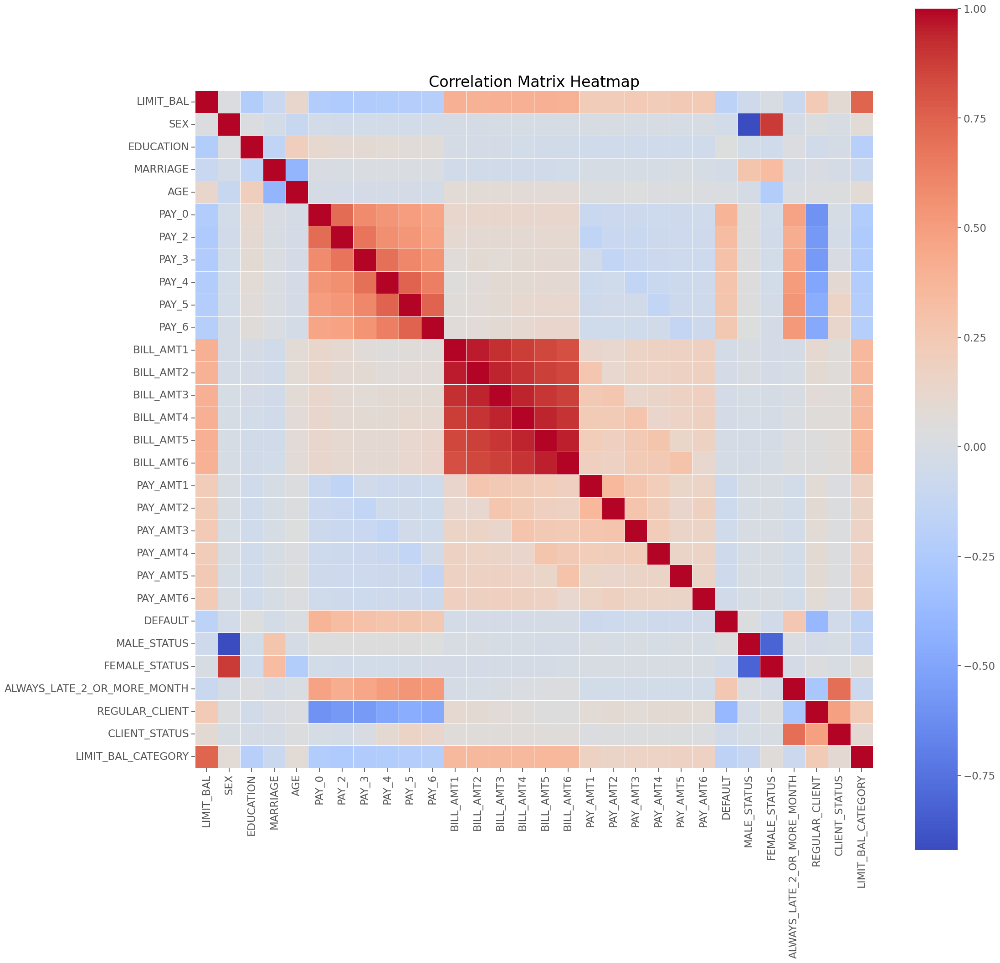

In [ ]:
# EDA: Correlations
corr = df.corr()

fig, ax = plt.subplots(figsize=(24,24))
sns.heatmap(corr, cbar = True,  square = True, annot = False, fmt= '.1f',
            xticklabels= True, yticklabels= True, cmap='coolwarm', linewidths=.5, ax=ax)
plt.title('Correlation Matrix Heatmap', size=24)
plt.show()

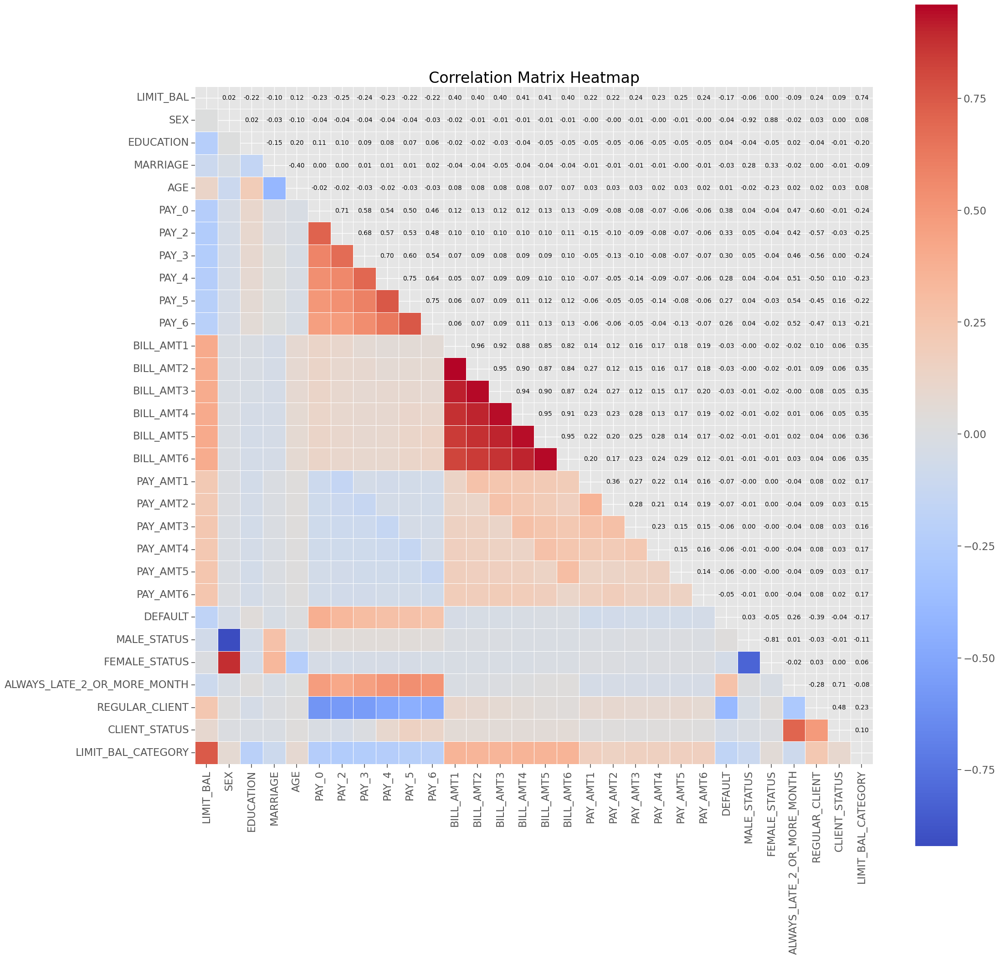

In [ ]:
# EDA: Correlations with values on the plot itself
corr_val = df.corr()
mask = np.triu(np.ones_like(corr_val, dtype=bool))
fig, ax = plt.subplots(figsize=(24, 24))
sns.heatmap(corr_val, mask=mask, cbar=True, square=True, annot=False, fmt='.1f',
            xticklabels=True, yticklabels=True, cmap='coolwarm', linewidths=.5, ax=ax)

for i in range(len(corr_val.columns)):
    for j in range(i+1, len(corr_val.columns)):
        ax.text(j + 0.5, i + 0.5, f'{corr_val.iloc[i, j]:.2f}', ha='center', va='center', color='black', fontsize=10)

plt.title('Correlation Matrix Heatmap', size=24)
plt.show()


In [ ]:
# EDA: Define features and target variable
X = df.drop('DEFAULT', axis = 1, inplace = False)
y = df['DEFAULT']

In [ ]:
# EDA: Define features and target variable
X_full = df_temp.drop('DEFAULT', axis = 1, inplace = False)
y_full = df_temp['DEFAULT']

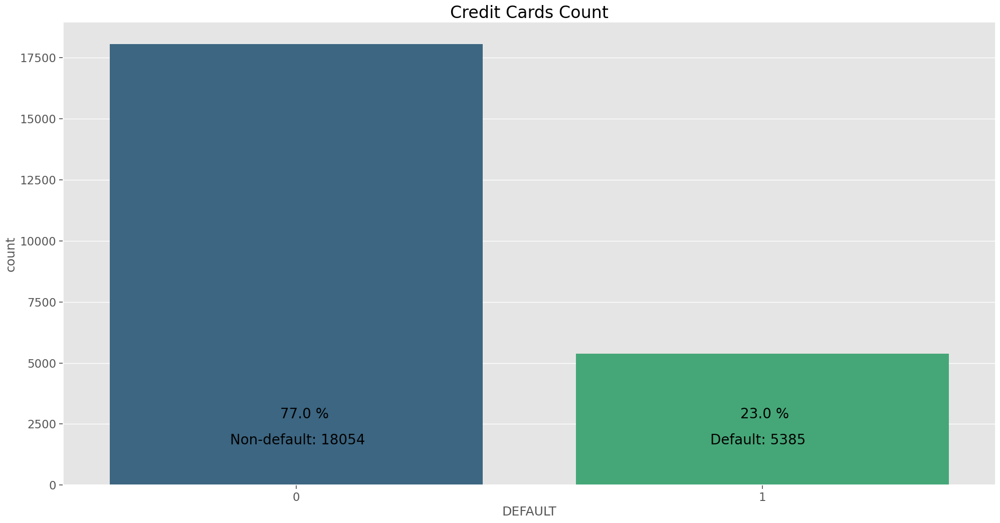

In [ ]:
# EDA: Target variable (credit card defaults)
n_total_count       = len(y)
n_default_count     = y.sum()
n_non_default_count = n_total_count - n_default_count
n_default_pct       = round(100 * n_default_count / n_total_count, 1)
n_non_default_pct   = round(100 * n_non_default_count / n_total_count, 1)

# EDA: Plot count of defaults and non-defaults on credit cards
plt.figure(figsize=(24,12))

sns.set_context('notebook', font_scale=1.5)

sns.countplot(x='DEFAULT', data=df, palette='viridis')
plt.title('Credit Cards Count', size=24)

plt.annotate('Default: {}'.format(n_default_count), xycoords = 'subfigure fraction', xy=(0.71, 0.15), xytext=(0.71, 0.15), size=20)
plt.annotate('Non-default: {}'.format(n_non_default_count), xycoords = 'subfigure fraction', xy=(0.23, 0.15), xytext=(0.23, 0.15), size=20)
plt.annotate(str(n_default_pct)+' %', xycoords = 'subfigure fraction', xy=(0.74, 0.20), xytext=(0.74, 0.20), size=20)
plt.annotate(str(n_non_default_pct)+' %', xycoords = 'subfigure fraction', xy=(0.28, 0.20), xytext=(0.28, 0.20), size=20)

plt.show()

####Standardization and data splitting

In [ ]:
# EDA: Standardization
X_scaled = (X - X.mean()) / (X.std())
X_full_scaled = (X_full - X_full.mean()) / (X_full.std())

In [ ]:
# Model: Create train and test datasets (original and standardized features)
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)
X_scaled_train, X_scaled_test, y_scaled_train, y_scaled_test = train_test_split(X_scaled, y, test_size=0.2,
                                                                                stratify=y, random_state=42)

In [ ]:
# Model: Create train and test datasets (original and standardized features) with original dataframe
#X_full_train, X_full_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)
X_full_scaled_train, X_full_scaled_test, y_full_scaled_train, y_full_scaled_test = train_test_split(X_full_scaled, y_full, test_size=0.2,
                                                                                stratify=y_full, random_state=42)

Recursive Feature Selection (RFE) using engineered dataframe

In [ ]:
# Recursive feature selection
n_features = 5
logit_model = LogisticRegression()
rfe_scaled  = RFE(estimator=logit_model,
                  n_features_to_select=n_features
                 )
fit_scaled  = rfe_scaled.fit(X_scaled, y)

print('Number of features:', fit_scaled.n_features_)
print('Selected features:', fit_scaled.support_)
print('Ranking of model features:', fit_scaled.ranking_)

score_scaled = rfe_scaled.score(X_scaled,y)
print('Standardized model score with selected features is: %f (%f)' % (score_scaled.mean(), score_scaled.std()))

feature_names = np.array(X_scaled.columns)
print('Most important features (RFE): %s'% feature_names[rfe_scaled.support_])

Number of features: 5
Selected features: [ True  True False False False  True False False False False False False
 False False False False False False False False False False False  True
 False False  True False False]
Ranking of model features: [ 1  1 11  9 15  1 17 23 24 13 14  3  2  8 22 12 25  4  6 21 18 16 20  1
 19  5  1  7 10]
Standardized model score with selected features is: 0.817228 (0.000000)
Most important features (RFE): ['LIMIT_BAL' 'SEX' 'PAY_0' 'MALE_STATUS' 'REGULAR_CLIENT']


Recursive Feature Selection (RFE) with original dataframe


In [ ]:
# Recursive feature selection with original dataframe

fit_full_scaled  = rfe_scaled.fit(X_full_scaled, y_full)

print('Number of features:', fit_full_scaled.n_features_)
print('Selected features:', fit_full_scaled.support_)
print('Ranking of model features:', fit_full_scaled.ranking_)

score_full_scaled = rfe_scaled.score(X_full_scaled,y_full)
print('Standardized model score with selected features is: %f (%f)' % (score_full_scaled.mean(), score_full_scaled.std()))

feature_full_names = np.array(X_full_scaled.columns)
print('Most important features (RFE): %s'% feature_full_names[rfe_scaled.support_])

Number of features: 5
Selected features: [False False False False False  True False False False False False  True
 False  True False False False  True  True False False False False]
Ranking of model features: [ 6 13  7  5  8  1  4  2 16 12 19  1  3  1 18 10 17  1  1 11  9 14 15]
Standardized model score with selected features is: 0.812467 (0.000000)
Most important features (RFE): ['PAY_0' 'BILL_AMT1' 'BILL_AMT3' 'PAY_AMT1' 'PAY_AMT2']


###Logistic Regression

####Logistic Regression with Engineered dataframe and it's optimal parameters

In [ ]:
# Define the cross-validation approach
n_cv_logit = 5

# Define the maximum number of iterations
n_max_iter = 500

# Create an instance of the class LogisticRegression
logit_model = LogisticRegression(max_iter=n_max_iter)

# Define the search space for the hyperparameters
search_space = dict()
search_space['penalty'] = ['none', 'l1', 'l2', 'elasticnet']
search_space['solver']  = ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']
search_space['C']       = [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1, 10, 100]

# Create an instance of the class GridSearchCV with desired characteristics
logit_grid_search_cv_original_scaled = GridSearchCV(estimator=logit_model,
                                             param_grid=search_space,
                                             scoring='accuracy',
                                             cv=n_cv_logit,
                                             n_jobs=-1
                                            )

# Run the search algorithm and summarize resuts
logit_grid_search_cv_original_scaled.fit(X_scaled_train, y_scaled_train)

print(f'Best score: {logit_grid_search_cv_original_scaled.best_score_:.4f}')
print('Best hyperparameters: %s' % logit_grid_search_cv_original_scaled.best_params_)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
360 fits failed out of a total of 800.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
40 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 1162, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 71, in _check_solver
    raise ValueError("penalty='none' 

Best score: 0.8148
Best hyperparameters: {'C': 0.01, 'penalty': 'l1', 'solver': 'liblinear'}


Predictions for logistic regression using engineered dataframe

In [ ]:
# Create an instance of the class LogisticRegression with specific selection of hyperparameters
logit_ccd_original = LogisticRegression(penalty=logit_grid_search_cv_original_scaled.best_params_['penalty'],
                                        solver=logit_grid_search_cv_original_scaled.best_params_['solver'],
                                        C=logit_grid_search_cv_original_scaled.best_params_['C'])

# Fit the model
logit_ccd_original.fit(X_scaled_train, y_scaled_train)
print('Logistic regression coefficients:')
print(logit_ccd_original.coef_.T)
print(100*'-')

# Predict outcomes in the training and testing subsamples and calculate accuracy
y_pred_train = logit_ccd_original.predict(X_scaled_train)

# To be used when one wants to change the threshold
#y_pred_train = (logit_ccd_original.predict_proba(X_train)[:,1]>=0.25).astype(int)

print(f'Accuracy (train): {metrics.accuracy_score(y_pred_train,y_scaled_train):.4f}')
print(100*'-')

y_pred_test  = logit_ccd_original.predict(X_scaled_test)

# To be used when one wants to change the threshold
#y_pred_test = (logit_ccd_original.predict_proba(X_test)[:,1]>=0.25).astype(int)

print(f'Accuracy (test): {metrics.accuracy_score(y_pred_test,y_scaled_test):.4f}')
print(100*'-')

## Calculate and display cross-validation scores for the training and testing subsamples
logit_cv_scores = cross_val_score(logit_ccd_original, X_scaled_train, y_scaled_train, cv=n_cv_logit)
print(f'Average CV score (+/- one standard deviation): {logit_cv_scores.mean():.4f} +/- {logit_cv_scores.std():.4f}')

print(classification_report(y_scaled_train, y_pred_train))
print(classification_report(y_scaled_test, y_pred_test))

Logistic regression coefficients:
[[-0.14086652]
 [ 0.        ]
 [ 0.        ]
 [-0.04320508]
 [ 0.00786857]
 [ 0.39077673]
 [ 0.03093994]
 [ 0.        ]
 [ 0.00094139]
 [ 0.02482634]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [-0.01860673]
 [-0.04947679]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [-0.02692911]
 [ 0.14657829]
 [-0.51638257]
 [ 0.        ]
 [-0.04283453]]
----------------------------------------------------------------------------------------------------
Accuracy (train): 0.8163
----------------------------------------------------------------------------------------------------
Accuracy (test): 0.8187
----------------------------------------------------------------------------------------------------
Average CV score (+/- one standard deviation): 0.8148 +/- 0.0027
              precision    recall  f1-score   support

           0       0.83      0.96      0.89     14443
    

#####Confusion Matrixes

Confusion Matrix for Logistic Regression ( Engineered dataframe) : Training
subsample

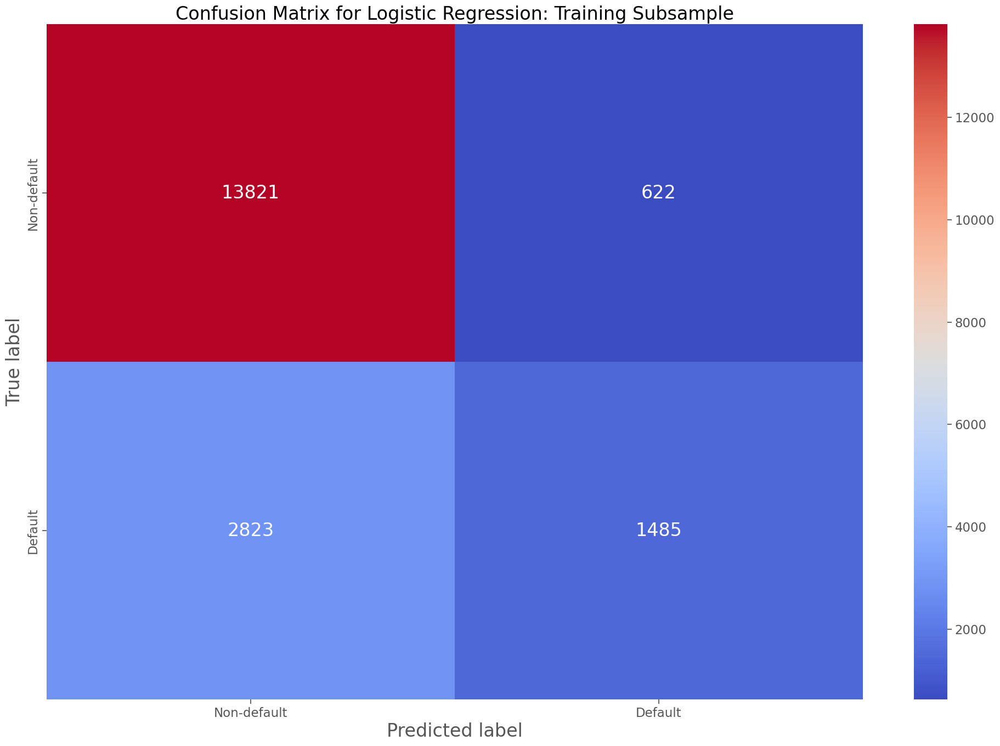

In [ ]:
# Plot the confusion matrix (training subsample)
plt.figure(figsize=(24,16))
logit_ccd_confusion_train = confusion_matrix(y_scaled_train,y_pred_train)
sns.heatmap(logit_ccd_confusion_train,
            annot=True,
            annot_kws={'size':24},
            cmap='coolwarm',
            fmt='d',
            xticklabels = ['Non-default', 'Default'],
            yticklabels = ['Non-default', 'Default']
           )
plt.ylabel('True label', size=24)
plt.xlabel('Predicted label', size=24)
plt.title('Confusion Matrix for Logistic Regression: Training Subsample', size=24)
plt.show()

Confusion Matrix for Logistic Regression ( Engineered dataframe) : Testing subsample

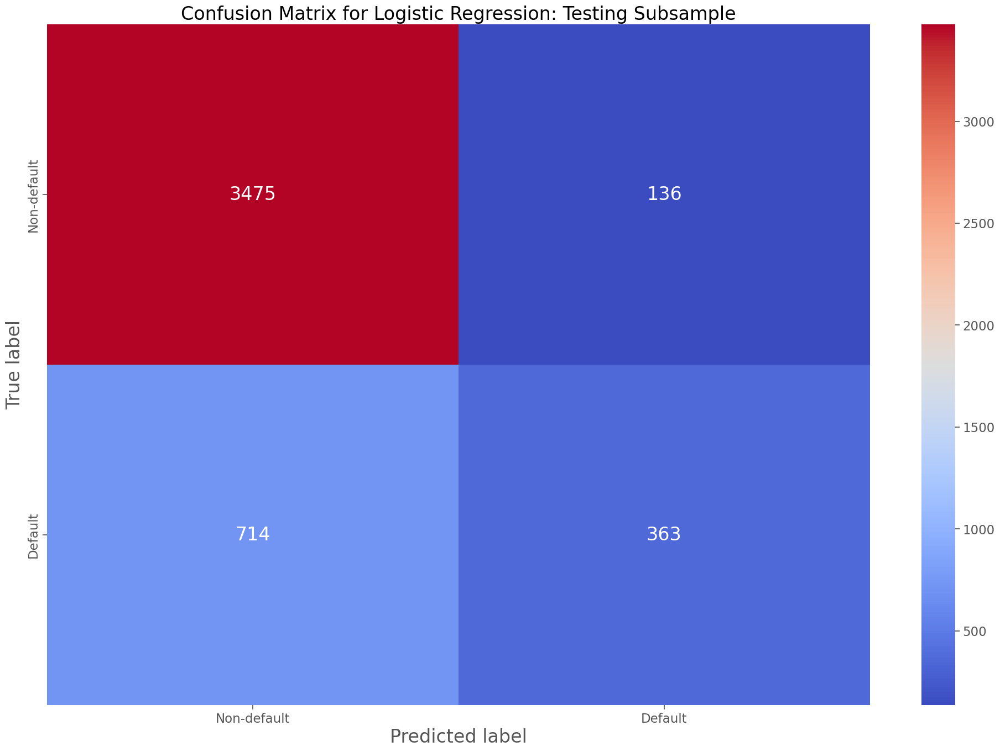

In [ ]:
# Plot the confusion matrix (testing subsample)
plt.figure(figsize=(24,16))
logit_ccd_confusion_test = confusion_matrix(y_scaled_test,y_pred_test)
sns.heatmap(logit_ccd_confusion_test,
            annot=True,
            annot_kws={'size':24},
            cmap='coolwarm',
            fmt='d',
            xticklabels = ['Non-default', 'Default'],
            yticklabels = ['Non-default', 'Default']
           )
plt.ylabel('True label', size=24)
plt.xlabel('Predicted label', size=24)
plt.title('Confusion Matrix for Logistic Regression: Testing Subsample', size=24)
plt.show()

####Logistic regression with Original dataframe and it's optimal parameters

In [ ]:
# # Define the cross-validation approach
# n_cv_logit = 5

# # Define the maximum number of iterations
# n_max_iter = 500

# # Create an instance of the class LogisticRegression
# logit_model = LogisticRegression(max_iter=n_max_iter)

# # Define the search space for the hyperparameters
# search_space = dict()
# search_space['penalty'] = ['none', 'l1', 'l2', 'elasticnet']
# search_space['solver']  = ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga']
# search_space['C']       = [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1, 10, 100]

# Create an instance of the class GridSearchCV with desired characteristics
logit_grid_search_cv_original_full = GridSearchCV(estimator=logit_model,
                                             param_grid=search_space,
                                             scoring='accuracy',
                                             cv=n_cv_logit,
                                             n_jobs=-1
                                            )

# Run the search algorithm and summarize resuts
logit_grid_search_cv_original_full.fit(X_full_scaled_train, y_full_scaled_train)

print(f'Best score: {logit_grid_search_cv_original_full.best_score_:.4f}')
print('Best hyperparameters: %s' % logit_grid_search_cv_original_full.best_params_)

/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
360 fits failed out of a total of 800.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
40 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 1162, in fit
    solver = _check_solver(self.solver, self.penalty, self.dual)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py", line 71, in _check_solver
    raise ValueError("penalty='none' 

Best score: 0.8114
Best hyperparameters: {'C': 1, 'penalty': 'l1', 'solver': 'liblinear'}


Predictions for logistic regression using original dataframe

In [ ]:
# Create an instance of the class LogisticRegression with specific selection of hyperparameters
logit_ccd_original_full = LogisticRegression(penalty=logit_grid_search_cv_original_full.best_params_['penalty'],
                                        solver=logit_grid_search_cv_original_full.best_params_['solver'],
                                        C=logit_grid_search_cv_original_full.best_params_['C'])

# Fit the model
logit_ccd_original_full.fit(X_full_scaled_train, y_full_scaled_train)
print('Logistic regression coefficients:')
print(logit_ccd_original_full.coef_.T)
print(100*'-')

# Predict outcomes in the training and testing subsamples and calculate accuracy
y_pred_train_full = logit_ccd_original_full.predict(X_full_scaled_train)

# To be used when one wants to change the threshold
#y_pred_train_full = (logit_ccd_original_full.predict_proba(X_full_scaled_train)[:,1]>=0.25).astype(int)

print(f'Accuracy (train): {metrics.accuracy_score(y_pred_train_full,y_full_scaled_train):.4f}')
print(100*'-')

y_pred_test_full  = logit_ccd_original_full.predict(X_full_scaled_test)

# To be used when one wants to change the threshold
#y_pred_test_full = (logit_ccd_original_full.predict_proba(X_scaled_test)[:,1]>=0.25).astype(int)

print(f'Accuracy (test): {metrics.accuracy_score(y_pred_test_full,y_full_scaled_test):.4f}')
print(100*'-')

## Calculate and display cross-validation scores for the training and testing subsamples
logit_cv_scores_full = cross_val_score(logit_ccd_original_full, X_full_scaled_train, y_full_scaled_train, cv=n_cv_logit)
print(f'Average CV score (+/- one standard deviation): {logit_cv_scores_full.mean():.4f} +/- {logit_cv_scores_full.std():.4f}')

print(classification_report(y_full_scaled_train, y_pred_train_full))
print(classification_report(y_full_scaled_test, y_pred_test_full))

Logistic regression coefficients:
[[-0.13396471]
 [-0.05638908]
 [-0.09083247]
 [-0.08266259]
 [ 0.06967704]
 [ 0.66108217]
 [ 0.09269897]
 [ 0.09766491]
 [ 0.06183475]
 [ 0.        ]
 [ 0.01651578]
 [-0.30463344]
 [ 0.08564241]
 [ 0.0315259 ]
 [ 0.05018208]
 [ 0.02448506]
 [ 0.        ]
 [-0.20027315]
 [-0.20224773]
 [-0.03425255]
 [-0.03879323]
 [-0.02341903]
 [-0.02877092]]
----------------------------------------------------------------------------------------------------
Accuracy (train): 0.8118
----------------------------------------------------------------------------------------------------
Accuracy (test): 0.8083
----------------------------------------------------------------------------------------------------
Average CV score (+/- one standard deviation): 0.8114 +/- 0.0035
              precision    recall  f1-score   support

           0       0.82      0.97      0.89     18691
           1       0.72      0.25      0.37      5309

    accuracy                           

#####Confusion matrixes

Confusion Matrix for Logistic Regression ( Original dataframe) : Training
subsample

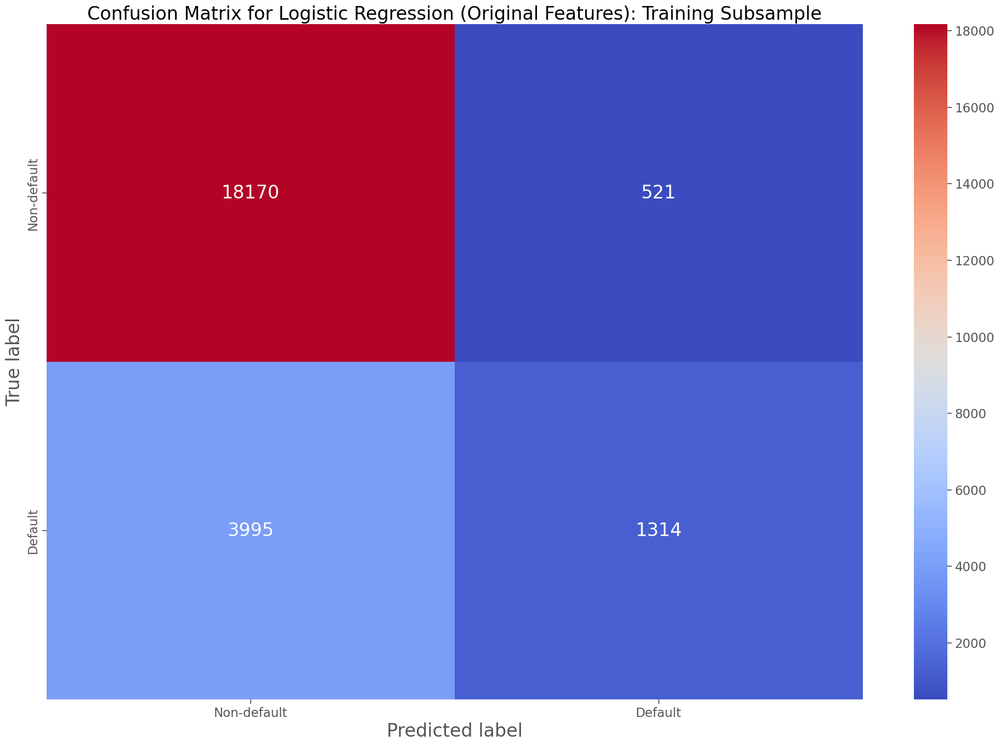

In [ ]:
# Plot the confusion matrix (training subsample)
plt.figure(figsize=(24,16))
logit_ccd_confusion_train_full = confusion_matrix(y_full_scaled_train,y_pred_train_full)
sns.heatmap(logit_ccd_confusion_train_full,
            annot=True,
            annot_kws={'size':24},
            cmap='coolwarm',
            fmt='d',
            xticklabels = ['Non-default', 'Default'],
            yticklabels = ['Non-default', 'Default']
           )
plt.ylabel('True label', size=24)
plt.xlabel('Predicted label', size=24)
plt.title('Confusion Matrix for Logistic Regression (Original Features): Training Subsample', size=24)
plt.show()

Confusion Matrix for Logistic Regression ( Original dataframe) : Testing subsample

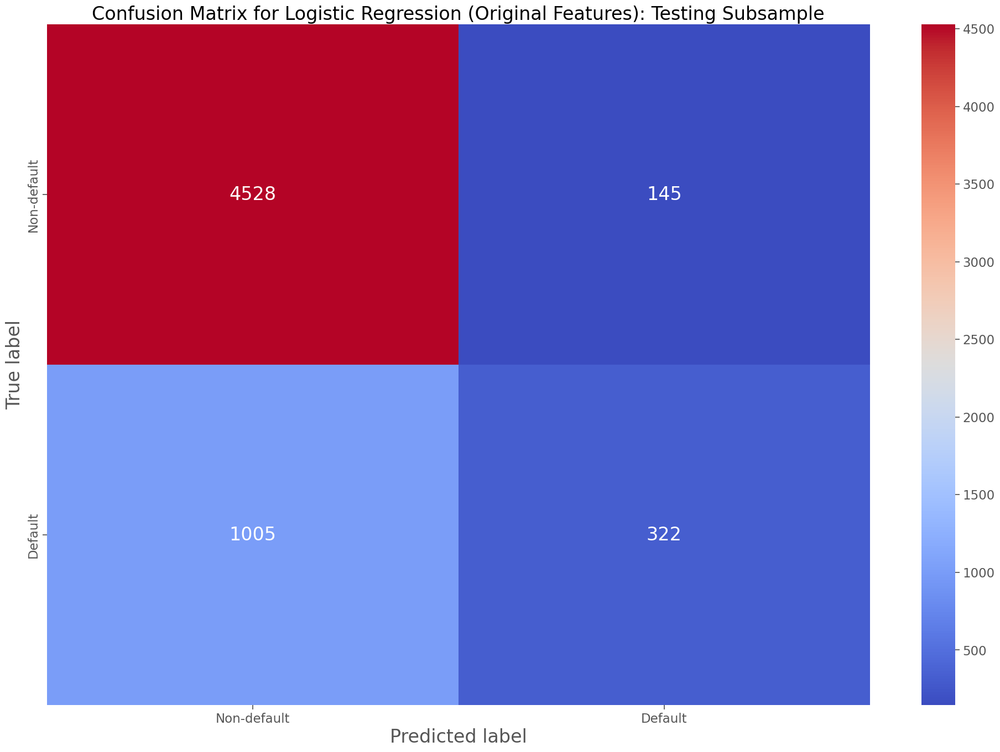

In [ ]:
# Plot the confusion matrix (testing subsample)
plt.figure(figsize=(24,16))
logit_ccd_confusion_test_full = confusion_matrix(y_full_scaled_test,y_pred_test_full)
sns.heatmap(logit_ccd_confusion_test_full,
            annot=True,
            annot_kws={'size':24},
            cmap='coolwarm',
            fmt='d',
            xticklabels = ['Non-default', 'Default'],
            yticklabels = ['Non-default', 'Default']
           )
plt.ylabel('True label', size=24)
plt.xlabel('Predicted label', size=24)
plt.title('Confusion Matrix for Logistic Regression (Original Features): Testing Subsample', size=24)
plt.show()

####Metrics for both Logistic regression models

Metrics for Testing subsample for enginereed dataframe

In [ ]:
print(classification_report(y_scaled_test, y_pred_test))

              precision    recall  f1-score   support

           0       0.83      0.96      0.89      3611
           1       0.73      0.34      0.46      1077

    accuracy                           0.82      4688
   macro avg       0.78      0.65      0.68      4688
weighted avg       0.81      0.82      0.79      4688



Metrics for Testing subsample for original dataframe

In [ ]:
print(classification_report(y_full_scaled_test, y_pred_test_full))

              precision    recall  f1-score   support

           0       0.82      0.97      0.89      4673
           1       0.69      0.24      0.36      1327

    accuracy                           0.81      6000
   macro avg       0.75      0.61      0.62      6000
weighted avg       0.79      0.81      0.77      6000



**Conclusion is that metrics for class we are trying to predict are higher on dataframe we have created, with addition of new features after feature engineering procees.**

####Optimal Probability Threshold for Logistic regression

#####Optimal threshold findings for engineered dataframe using ROC curve


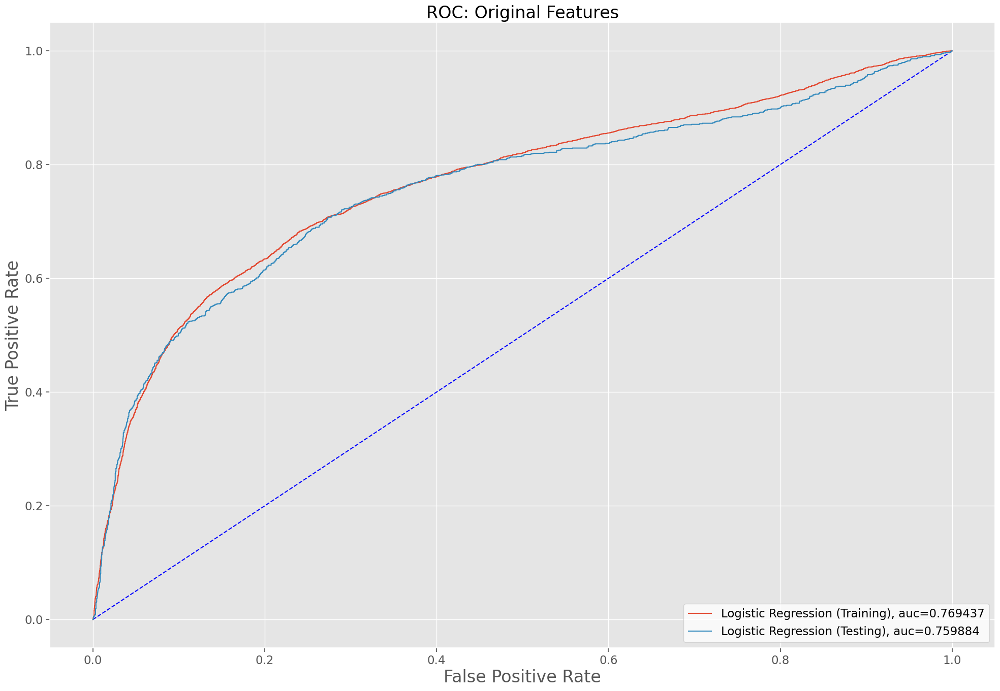

In [ ]:
# Estimate probabilities, and calcualate relevant ROC/AUC scores for the training and testing subsamples
y_pred_proba_train      = logit_ccd_original.predict_proba(X_scaled_train)[::,1]
fpr_train, tpr_train, threshold_train = metrics.roc_curve(y_scaled_train, y_pred_proba_train)
auc_train               = metrics.roc_auc_score(y_scaled_train, y_pred_proba_train)

y_pred_proba_test      = logit_ccd_original.predict_proba(X_scaled_test)[::,1]
fpr_test, tpr_test, threshold_test  = metrics.roc_curve(y_scaled_test, y_pred_proba_test)
auc_test               = metrics.roc_auc_score(y_scaled_test, y_pred_proba_test)

# Plot the ROC curve
plt.figure(figsize=(24,16))
plt.plot([0, 1], [0, 1], 'b--')
plt.plot(fpr_train,
         tpr_train,
         label='Logistic Regression (Training), auc='+str(round(auc_train,6))
        )
plt.plot(fpr_test,
         tpr_test,
         label='Logistic Regression (Testing), auc='+str(round(auc_test,6))
        )
plt.legend(loc=4, facecolor='white')
plt.xlabel('False Positive Rate', size=24)
plt.ylabel('True Positive Rate', size=24)
plt.title('ROC: Original Features', size=24)
plt.show()

In [ ]:
# Calculate the geometric mean for each threshold for the training and testing subsamples
vec_gmeans_train = np.sqrt(tpr_train * (1-fpr_train))
vec_gmeans_test  = np.sqrt(tpr_test * (1-fpr_test))

# locate the index of the largest g-mean
ix_train = np.argmax(vec_gmeans_train)
ix_test  = np.argmax(vec_gmeans_test)

# Summarize the results
print('Training (Original features):')
print('Best threshold = %f, Geometric mean = %.3f' % (threshold_train[ix_train], vec_gmeans_train[ix_train]))
print(100*'-')
print('Testing (Original features):')
print('Best threshold = %f, Geometric mean = %.3f' % (threshold_test[ix_test], vec_gmeans_test[ix_test]))
print(100*'-')

Training (Original features):
Best threshold = 0.201175, Geometric mean = 0.720
----------------------------------------------------------------------------------------------------
Testing (Original features):
Best threshold = 0.163547, Geometric mean = 0.717
----------------------------------------------------------------------------------------------------


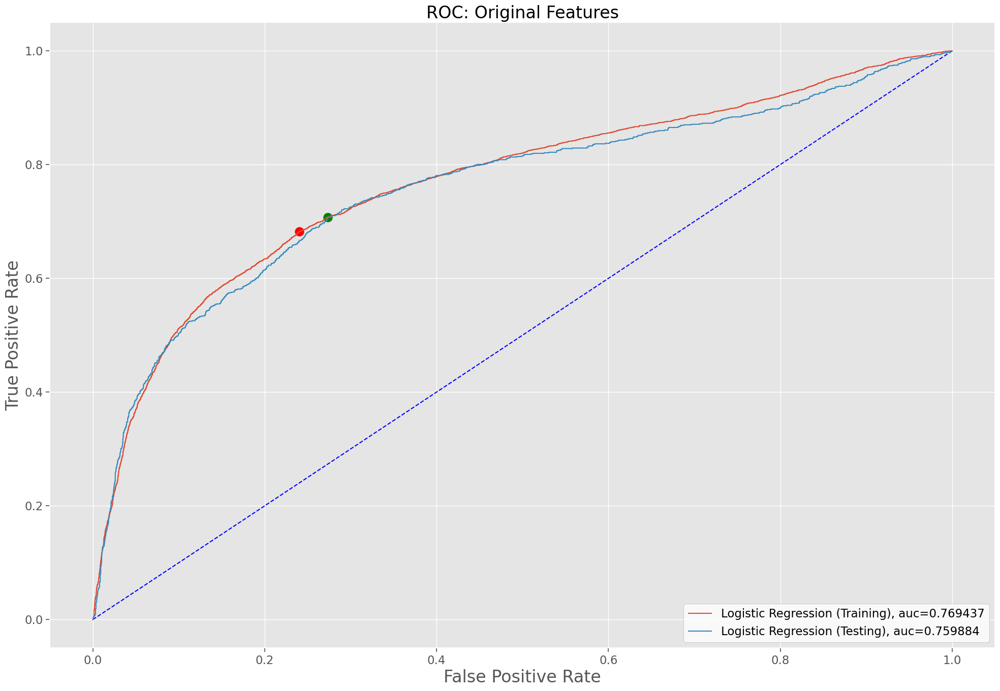

In [ ]:
# Estimate probabilities, and calcualate relevant ROC/AUC scores for the training and testing subsamples
y_pred_proba_train      = logit_ccd_original.predict_proba(X_scaled_train)[::,1]
fpr_train, tpr_train, threshold_train = metrics.roc_curve(y_scaled_train, y_pred_proba_train)
auc_train               = metrics.roc_auc_score(y_scaled_train, y_pred_proba_train)

y_pred_proba_test      = logit_ccd_original.predict_proba(X_scaled_test)[::,1]
fpr_test, tpr_test, threshold_test  = metrics.roc_curve(y_scaled_test, y_pred_proba_test)
auc_test               = metrics.roc_auc_score(y_scaled_test, y_pred_proba_test)

# Plot the ROC curve
plt.figure(figsize=(24,16))
plt.plot([0, 1], [0, 1], 'b--')
plt.plot(fpr_train,
         tpr_train,
         label='Logistic Regression (Training), auc='+str(round(auc_train,6))
        )
plt.plot(fpr_test,
         tpr_test,
         label='Logistic Regression (Testing), auc='+str(round(auc_test,6))
        )
plt.scatter(fpr_train[ix_train],
            tpr_train[ix_train],
            marker='o',
            color='red',
            s=150
           )
plt.scatter(fpr_test[ix_test],
            tpr_test[ix_test],
            marker='o',
            color='green',
            s=150
           )
plt.legend(loc=4, facecolor='white')
plt.xlabel('False Positive Rate', size=24)
plt.ylabel('True Positive Rate', size=24)
plt.title('ROC: Original Features', size=24)
plt.show()

#####Optimal threshold findings for original dataframe using ROC curve



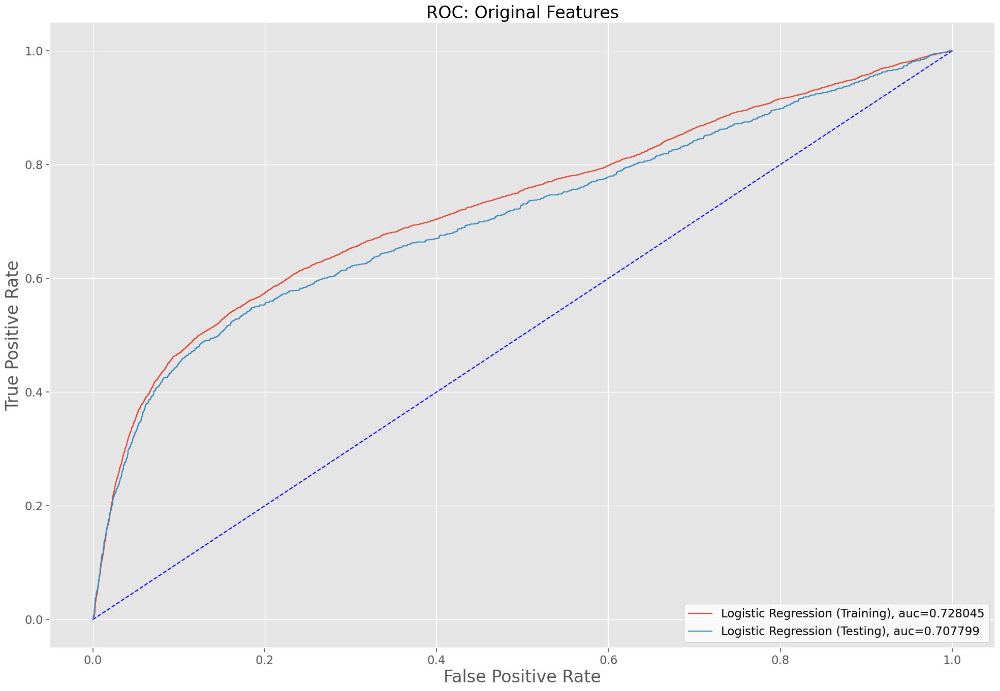

In [ ]:
# Estimate probabilities, and calcualate relevant ROC/AUC scores for the training and testing subsamples
y_pred_proba_train_full      = logit_ccd_original_full.predict_proba(X_full_scaled_train)[::,1]
fpr_train_full, tpr_train_full, threshold_train_full = metrics.roc_curve(y_full_scaled_train, y_pred_proba_train_full)
auc_train_full               = metrics.roc_auc_score(y_full_scaled_train, y_pred_proba_train_full)

y_pred_proba_test_full      = logit_ccd_original_full.predict_proba(X_full_scaled_test)[::,1]
fpr_test_full, tpr_test_full, threshold_test_full  = metrics.roc_curve(y_full_scaled_test, y_pred_proba_test_full)
auc_test_full               = metrics.roc_auc_score(y_full_scaled_test, y_pred_proba_test_full)

# Plot the ROC curve
plt.figure(figsize=(24,16))
plt.plot([0, 1], [0, 1], 'b--')
plt.plot(fpr_train_full,
         tpr_train_full,
         label='Logistic Regression (Training), auc='+str(round(auc_train_full,6))
        )
plt.plot(fpr_test_full,
         tpr_test_full,
         label='Logistic Regression (Testing), auc='+str(round(auc_test_full,6))
        )
plt.legend(loc=4, facecolor='white')
plt.xlabel('False Positive Rate', size=24)
plt.ylabel('True Positive Rate', size=24)
plt.title('ROC: Original Features', size=24)
plt.show()

In [ ]:
# Calculate the geometric mean for each threshold for the training and testing subsamples
vec_gmeans_train_full = np.sqrt(tpr_train_full * (1-fpr_train_full))
vec_gmeans_test_full  = np.sqrt(tpr_test_full * (1-fpr_test_full))

# locate the index of the largest g-mean
ix_train_full = np.argmax(vec_gmeans_train_full)
ix_test_full  = np.argmax(vec_gmeans_test_full)

# Summarize the results
print('Training (Original features):')
print('Best threshold = %f, Geometric mean = %.3f' % (threshold_train_full[ix_train_full], vec_gmeans_train[ix_train_full]))
print(100*'-')
print('Testing (Original features):')
print('Best threshold = %f, Geometric mean = %.3f' % (threshold_test_full[ix_test_full], vec_gmeans_test[ix_test_full]))
print(100*'-')

Training (Original features):
Best threshold = 0.234259, Geometric mean = 0.705
----------------------------------------------------------------------------------------------------
Testing (Original features):
Best threshold = 0.252898, Geometric mean = 0.711
----------------------------------------------------------------------------------------------------


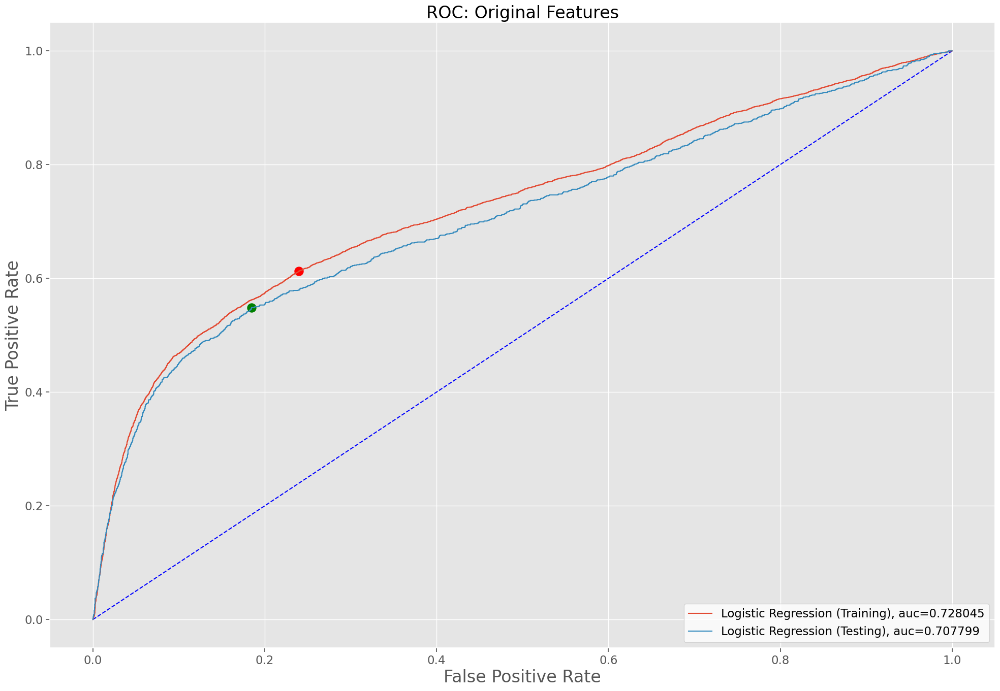

In [ ]:
# Estimate probabilities, and calcualate relevant ROC/AUC scores for the training and testing subsamples
y_pred_proba_train_full      = logit_ccd_original_full.predict_proba(X_full_scaled_train)[::,1]
fpr_train_full, tpr_train_full, threshold_train_full = metrics.roc_curve(y_full_scaled_train, y_pred_proba_train_full)
auc_train_full               = metrics.roc_auc_score(y_full_scaled_train, y_pred_proba_train_full)

y_pred_proba_test_full      = logit_ccd_original_full.predict_proba(X_full_scaled_test)[::,1]
fpr_test_full, tpr_test_full, threshold_test_full  = metrics.roc_curve(y_full_scaled_test, y_pred_proba_test_full)
auc_test_full               = metrics.roc_auc_score(y_full_scaled_test, y_pred_proba_test_full)

# Plot the ROC curve
plt.figure(figsize=(24,16))
plt.plot([0, 1], [0, 1], 'b--')
plt.plot(fpr_train_full,
         tpr_train_full,
         label='Logistic Regression (Training), auc='+str(round(auc_train_full,6))
        )
plt.plot(fpr_test_full,
         tpr_test_full,
         label='Logistic Regression (Testing), auc='+str(round(auc_test_full,6))
        )
plt.scatter(fpr_train_full[ix_train_full],
            tpr_train_full[ix_train_full],
            marker='o',
            color='red',
            s=150
           )
plt.scatter(fpr_test_full[ix_test_full],
            tpr_test_full[ix_test_full],
            marker='o',
            color='green',
            s=150
           )
plt.legend(loc=4, facecolor='white')
plt.xlabel('False Positive Rate', size=24)
plt.ylabel('True Positive Rate', size=24)
plt.title('ROC: Original Features', size=24)
plt.show()

#####Predictions with optimal tresholds for engineered dataframe using ROC curve

Running prediction on engineered dataframe with optimal threshold value of 0.23 on Training, and 0.25 on Testing subsample.

In [ ]:
# Create an instance of the class LogisticRegression with specific selection of hyperparameters
logit_ccd_original_optimal = LogisticRegression(penalty=logit_grid_search_cv_original_scaled.best_params_['penalty'],
                                        solver=logit_grid_search_cv_original_scaled.best_params_['solver'],
                                        C=logit_grid_search_cv_original_scaled.best_params_['C'])
# Fit the model
logit_ccd_original_optimal.fit(X_scaled_train, y_scaled_train)
print('Logistic regression coefficients:')
print(logit_ccd_original_optimal.coef_.T)
print(100*'-')

# To be used when one wants to change the threshold
y_pred_train_optimal = (logit_ccd_original_optimal.predict_proba(X_scaled_train)[:,1]>=threshold_train[ix_train]).astype(int)

print(f'Accuracy (train): {metrics.accuracy_score(y_pred_train_optimal,y_scaled_train):.4f}')
print(100*'-')

# To be used when one wants to change the threshold
y_pred_test_optimal = (logit_ccd_original_optimal.predict_proba(X_scaled_test)[:,1]>=threshold_test[ix_test]).astype(int)

print(f'Accuracy (test): {metrics.accuracy_score(y_pred_test_optimal,y_scaled_test):.4f}')
print(100*'-')

## Calculate and display cross-validation scores for the training and testing subsamples
logit_cv_scores_optimal = cross_val_score(logit_ccd_original_optimal, X_scaled_train, y_scaled_train, cv=n_cv_logit)
print(f'Average CV score (+/- one standard deviation): {logit_cv_scores_optimal.mean():.4f} +/- {logit_cv_scores_optimal.std():.4f}')

print(classification_report(y_scaled_train, y_pred_train_optimal))
print(classification_report(y_scaled_test, y_pred_test_optimal))

Logistic regression coefficients:
[[-0.14076205]
 [ 0.        ]
 [ 0.        ]
 [-0.04320518]
 [ 0.007873  ]
 [ 0.39074891]
 [ 0.03098439]
 [ 0.        ]
 [ 0.00078753]
 [ 0.02490153]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [-0.01859103]
 [-0.04946656]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [-0.02692467]
 [ 0.14658838]
 [-0.51641309]
 [ 0.        ]
 [-0.04293774]]
----------------------------------------------------------------------------------------------------
Accuracy (train): 0.7419
----------------------------------------------------------------------------------------------------
Accuracy (test): 0.7216
----------------------------------------------------------------------------------------------------
Average CV score (+/- one standard deviation): 0.8148 +/- 0.0027
              precision    recall  f1-score   support

           0       0.89      0.76      0.82     14443
    

In [ ]:
print(classification_report(y_scaled_test, y_pred_test))

              precision    recall  f1-score   support

           0       0.83      0.96      0.89      3611
           1       0.73      0.34      0.46      1077

    accuracy                           0.82      4688
   macro avg       0.78      0.65      0.68      4688
weighted avg       0.81      0.82      0.79      4688



F1 metric, which represents harmonic mean of precision and recall is significantly smaller on Testing subsample with optimal threshold.

Confusion Matrix for Logistic regression when engineered features that use optimal threshold with AUC curve.

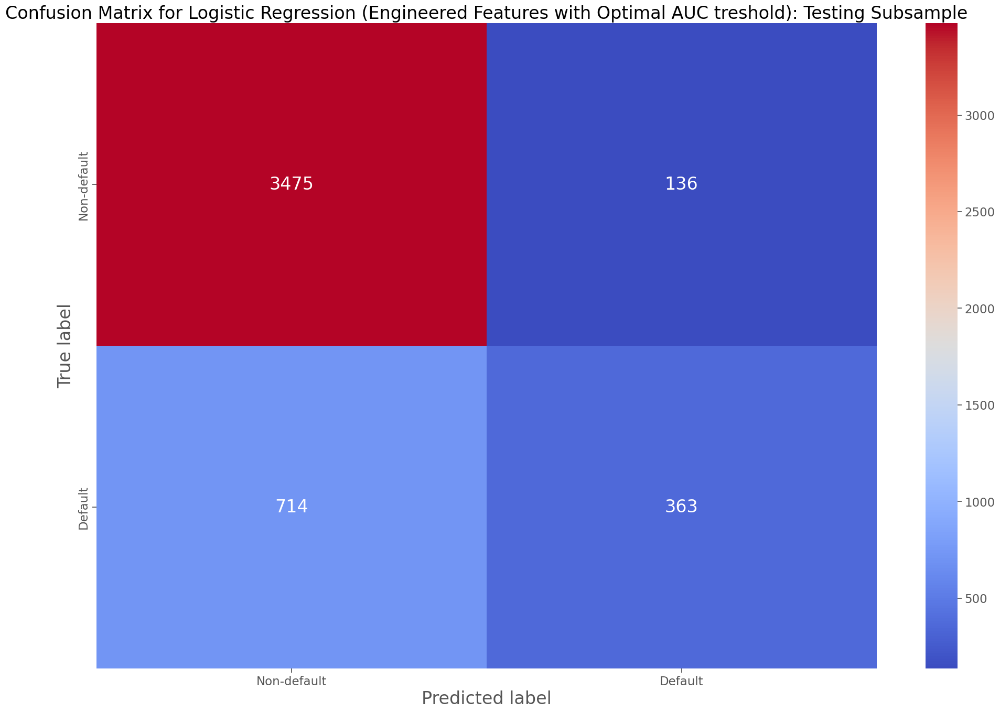

In [ ]:
# Plot the confusion matrix (testing subsample)
plt.figure(figsize=(24,16))
logit_ccd_optimal_threshold_auc = confusion_matrix(y_scaled_test,y_pred_test)
sns.heatmap(logit_ccd_optimal_threshold_auc,
            annot=True,
            annot_kws={'size':24},
            cmap='coolwarm',
            fmt='d',
            xticklabels = ['Non-default', 'Default'],
            yticklabels = ['Non-default', 'Default']
           )
plt.ylabel('True label', size=24)
plt.xlabel('Predicted label', size=24)
plt.title('Confusion Matrix for Logistic Regression (Engineered Features with Optimal AUC treshold): Testing Subsample', size=24)
plt.show()

#####Predictions with optimal tresholds for original dataframe using ROC curve

Running prediction on original dataframe with optimal threshold value of 0.2 on Training, and 0.16 on Testing subsample.

In [ ]:
# Create an instance of the class LogisticRegression with specific selection of hyperparameters
logit_ccd_original_optimal_full = LogisticRegression(penalty=logit_grid_search_cv_original_full.best_params_['penalty'],
                                        solver=logit_grid_search_cv_original_full.best_params_['solver'],
                                        C=logit_grid_search_cv_original_full.best_params_['C'])
# Fit the model
logit_ccd_original_optimal_full.fit(X_full_scaled_train, y_full_scaled_train)
print('Logistic regression coefficients:')
print(logit_ccd_original_optimal_full.coef_.T)
print(100*'-')

# To be used when one wants to change the threshold
y_pred_train_optimal_full = (logit_ccd_original_optimal_full.predict_proba(X_full_scaled_train)[:,1]>=threshold_train_full[ix_train_full]).astype(int)

print(f'Accuracy (train): {metrics.accuracy_score(y_pred_train_optimal_full,y_full_scaled_train):.4f}')
print(100*'-')

# To be used when one wants to change the threshold
y_pred_test_optimal_full = (logit_ccd_original_optimal_full.predict_proba(X_full_scaled_test)[:,1]>=threshold_test_full[ix_test_full]).astype(int)

print(f'Accuracy (test): {metrics.accuracy_score(y_pred_test_optimal_full,y_full_scaled_test):.4f}')
print(100*'-')

## Calculate and display cross-validation scores for the training and testing subsamples
logit_cv_scores_optimal_full = cross_val_score(logit_ccd_original_optimal_full, X_full_scaled_train, y_full_scaled_train, cv=n_cv_logit)
print(f'Average CV score (+/- one standard deviation): {logit_cv_scores_optimal_full.mean():.4f} +/- {logit_cv_scores_optimal_full.std():.4f}')

print(classification_report(y_full_scaled_train, y_pred_train_optimal_full))
print(classification_report(y_full_scaled_test, y_pred_test_optimal_full))

Logistic regression coefficients:
[[-0.13395643]
 [-0.05638982]
 [-0.09082876]
 [-0.08266248]
 [ 0.06967581]
 [ 0.66107924]
 [ 0.09270257]
 [ 0.09766631]
 [ 0.06183462]
 [ 0.        ]
 [ 0.01651509]
 [-0.30476362]
 [ 0.08590119]
 [ 0.03121539]
 [ 0.05029536]
 [ 0.02453133]
 [ 0.        ]
 [-0.20028939]
 [-0.20218979]
 [-0.03429009]
 [-0.03879498]
 [-0.0234184 ]
 [-0.02877022]]
----------------------------------------------------------------------------------------------------
Accuracy (train): 0.7276
----------------------------------------------------------------------------------------------------
Accuracy (test): 0.7563
----------------------------------------------------------------------------------------------------
Average CV score (+/- one standard deviation): 0.8114 +/- 0.0035
              precision    recall  f1-score   support

           0       0.87      0.76      0.81     18691
           1       0.42      0.61      0.50      5309

    accuracy                           

In [ ]:
print(classification_report(y_full_scaled_test, y_pred_test_full))

              precision    recall  f1-score   support

           0       0.82      0.97      0.89      4673
           1       0.69      0.24      0.36      1327

    accuracy                           0.81      6000
   macro avg       0.75      0.61      0.62      6000
weighted avg       0.79      0.81      0.77      6000



#####Optimal threshold findings for engineered dataframe using PR curve


Training (Original features):
Best threshold = 0.360738, F1 score = 0.564
----------------------------------------------------------------------------------------------------
Testing (Original features):
Best threshold = 0.379433, F1 score = 0.553
----------------------------------------------------------------------------------------------------


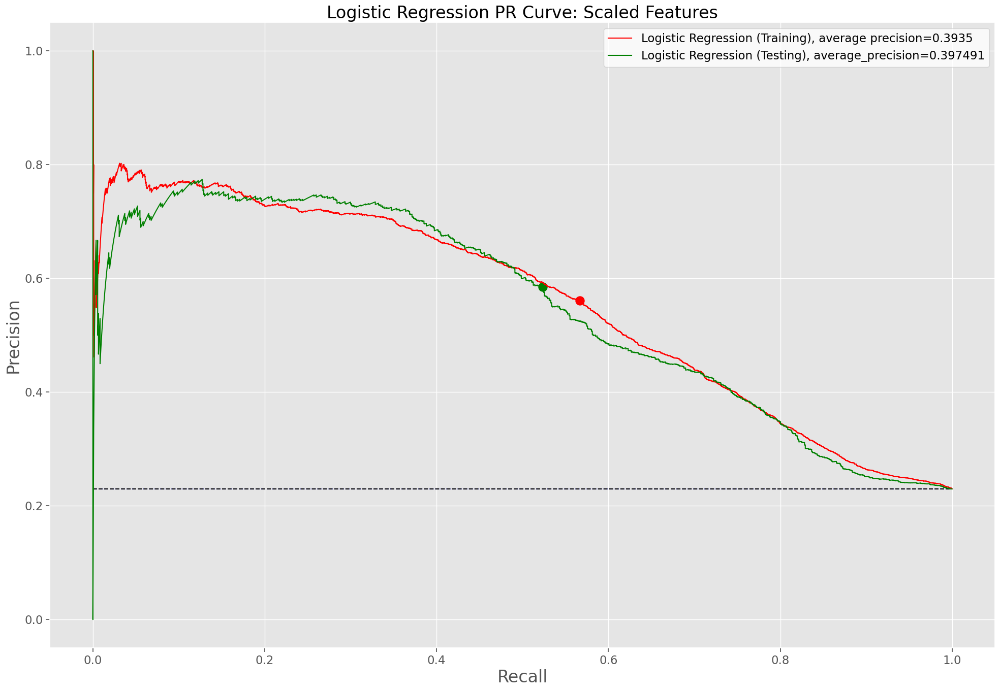

In [ ]:
# Calculate the precision and recall for different values of threshold in the training and testing subsamples
precision_train, recall_train, threshold_train = metrics.precision_recall_curve(y_scaled_train, y_pred_proba_train)
average_precision_train = metrics.average_precision_score(y_scaled_train, y_pred_train)

precision_test, recall_test, threshold_test = metrics.precision_recall_curve(y_scaled_test, y_pred_proba_test)
average_precision_test = metrics.average_precision_score(y_scaled_test, y_pred_test)

# Calculate the F1 score
vec_f1_train = 2 * precision_train * recall_train / (precision_train + recall_train)
mask = (precision_test + recall_test) != 0
vec_f1_test = np.zeros_like(precision_test)
vec_f1_test[mask] = 2 * precision_test[mask] * recall_test[mask] / (precision_test[mask] + recall_test[mask])
#vec_f1_test  = 2 * precision_test * recall_test / (precision_test + recall_test)

# locate the index of the largest F1 score
ix_f1_train = np.argmax(vec_f1_train)
ix_f1_test  = np.argmax(vec_f1_test)

# Summarize the results
print('Training (Original features):')
print('Best threshold = %f, F1 score = %.3f' % (threshold_train[ix_f1_train], vec_f1_train[ix_f1_train]))
print(100*'-')
print('Testing (Original features):')
print('Best threshold = %f, F1 score = %.3f' % (threshold_test[ix_f1_test], vec_f1_test[ix_f1_test]))
print(100*'-')

# Calculate benchmark values for the training and testing subsamples
nopower_scaled_train = len(y_scaled_train[y_scaled_train==1]) / len(y_scaled_train)
nopower_scaled_test  = len(y_scaled_test[y_scaled_test==1]) / len(y_scaled_test)

# Plot the PR curve
plt.figure(figsize=(24,16))
plt.plot([0, 1],
         [nopower_scaled_train, nopower_scaled_train],
         'b--'
        )
plt.plot([0, 1],
         [nopower_scaled_test, nopower_scaled_test],
         'k--'
        )
plt.plot(recall_train,
         precision_train,
         'r-',
         label='Logistic Regression (Training), average precision='+str(round(average_precision_train,6))
        )
plt.plot(recall_test,
         precision_test,
         'g-',
         label='Logistic Regression (Testing), average_precision='+str(round(average_precision_test,6))
        )
plt.scatter(recall_train[ix_f1_train],
            precision_train[ix_f1_train],
            marker='o',
            color='red',
            s=150
           )
plt.scatter(recall_test[ix_f1_test],
            precision_test[ix_f1_test],
            marker='o',
            color='green',
            s=150
           )
plt.legend(loc=1, facecolor='white')
plt.xlabel('Recall', size=24)
plt.ylabel('Precision', size=24)
plt.title('Logistic Regression PR Curve: Scaled Features', size=24)
plt.show()

Optimal thresholds using PR curve are 0.360738 for Training subsample, and 0.379430 for Testing subsample.

In [ ]:
# Create an instance of the class LogisticRegression with specific selection of hyperparameters
logit_ccd_original_optimal_pr = LogisticRegression(penalty=logit_grid_search_cv_original_scaled.best_params_['penalty'],
                                        solver=logit_grid_search_cv_original_scaled.best_params_['solver'],
                                        C=logit_grid_search_cv_original_scaled.best_params_['C'])
# Fit the model
logit_ccd_original_optimal_pr.fit(X_scaled_train, y_scaled_train)
print('Logistic regression coefficients:')
print(logit_ccd_original_optimal_pr.coef_.T)
print(100*'-')

# To be used when one wants to change the threshold
y_pred_train_optimal_pr = (logit_ccd_original_optimal_pr.predict_proba(X_scaled_train)[:,1]>=threshold_train[ix_f1_train]).astype(int)

print(f'Accuracy (train): {metrics.accuracy_score(y_pred_train_optimal_pr,y_scaled_train):.4f}')
print(100*'-')

# To be used when one wants to change the threshold
y_pred_test_optimal_pr = (logit_ccd_original_optimal_pr.predict_proba(X_scaled_test)[:,1]>=threshold_test[ix_f1_test]).astype(int)

print(f'Accuracy (test): {metrics.accuracy_score(y_pred_test_optimal_pr,y_scaled_test):.4f}')
print(100*'-')

## Calculate and display cross-validation scores for the training and testing subsamples
logit_cv_scores_optimal_pr = cross_val_score(logit_ccd_original_optimal_pr, X_scaled_train, y_scaled_train, cv=n_cv_logit)
print(f'Average CV score (+/- one standard deviation): {logit_cv_scores_optimal_pr.mean():.4f} +/- {logit_cv_scores_optimal_pr.std():.4f}')

print(classification_report(y_scaled_train, y_pred_train_optimal_pr))
print(classification_report(y_scaled_test, y_pred_test_optimal_pr))

Logistic regression coefficients:
[[-0.14068946]
 [ 0.        ]
 [ 0.        ]
 [-0.04320204]
 [ 0.0078664 ]
 [ 0.39082955]
 [ 0.03089898]
 [ 0.        ]
 [ 0.00084102]
 [ 0.02488393]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [-0.01862575]
 [-0.04948273]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [ 0.        ]
 [-0.02692417]
 [ 0.14659383]
 [-0.51638832]
 [ 0.        ]
 [-0.04300838]]
----------------------------------------------------------------------------------------------------
Accuracy (train): 0.7984
----------------------------------------------------------------------------------------------------
Accuracy (test): 0.8052
----------------------------------------------------------------------------------------------------
Average CV score (+/- one standard deviation): 0.8148 +/- 0.0027
              precision    recall  f1-score   support

           0       0.87      0.87      0.87     14443
    

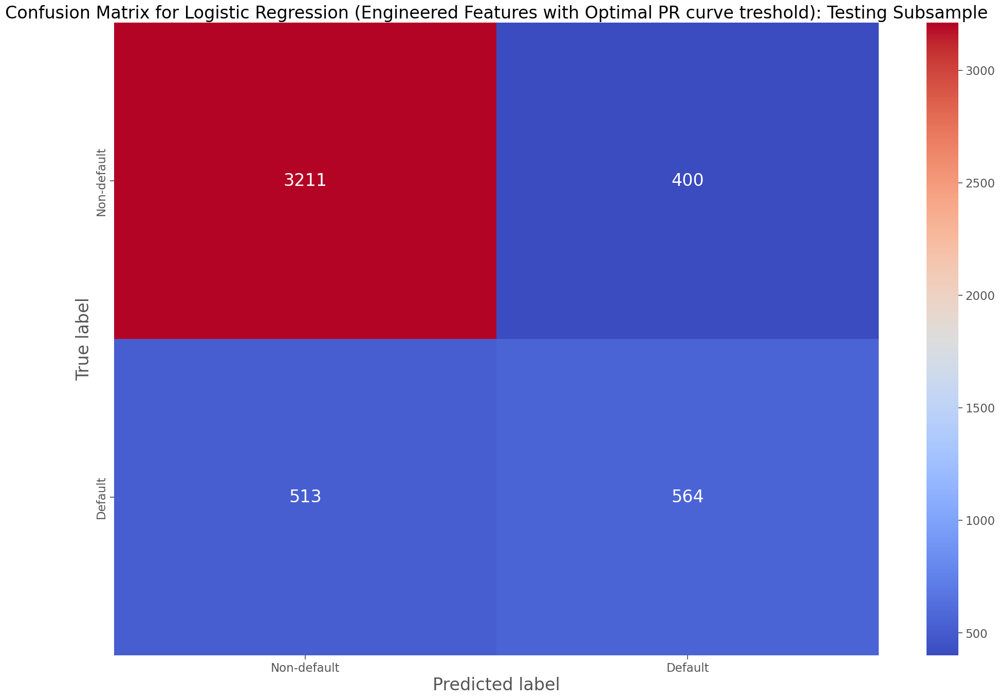

In [ ]:
# Plot the confusion matrix (testing subsample)
plt.figure(figsize=(24,16))
logit_ccd_optimal_threshold_pr = confusion_matrix(y_scaled_test,y_pred_test_optimal_pr)
sns.heatmap(logit_ccd_optimal_threshold_pr,
            annot=True,
            annot_kws={'size':24},
            cmap='coolwarm',
            fmt='d',
            xticklabels = ['Non-default', 'Default'],
            yticklabels = ['Non-default', 'Default']
           )
plt.ylabel('True label', size=24)
plt.xlabel('Predicted label', size=24)
plt.title('Confusion Matrix for Logistic Regression (Engineered Features with Optimal PR curve treshold): Testing Subsample', size=24)
plt.show()

#####Optimal threshold findings for original dataframe using PR curve


Training (Original features):
Best threshold = 0.280873, F1 score = 0.517
----------------------------------------------------------------------------------------------------
Testing (Original features):
Best threshold = 0.280775, F1 score = 0.504
----------------------------------------------------------------------------------------------------


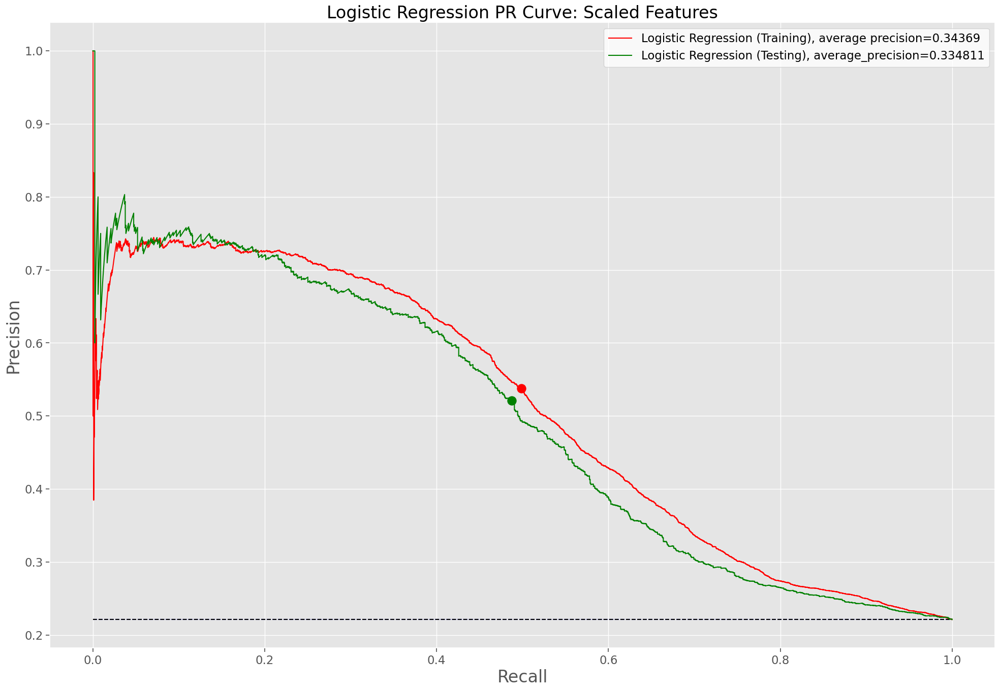

In [ ]:
# Calculate the precision and recall for different values of threshold in the training and testing subsamples
precision_train_full, recall_train_full, threshold_train_full = metrics.precision_recall_curve(y_full_scaled_train, y_pred_proba_train_full)
average_precision_train_full = metrics.average_precision_score(y_full_scaled_train, y_pred_train_full)

precision_test_full, recall_test_full, threshold_test_full = metrics.precision_recall_curve(y_full_scaled_test, y_pred_proba_test_full)
average_precision_test_full = metrics.average_precision_score(y_full_scaled_test, y_pred_test_full)

# Calculate the F1 score
vec_f1_train_full = 2 * precision_train_full * recall_train_full / (precision_train_full + recall_train_full)
mask_full = (precision_test_full + recall_test_full) != 0
vec_f1_test_full = np.zeros_like(precision_test_full)
vec_f1_test_full[mask_full] = 2 * precision_test_full[mask_full] * recall_test_full[mask_full] / (precision_test_full[mask_full] + recall_test_full[mask_full])

# locate the index of the largest F1 score
ix_f1_train_full = np.argmax(vec_f1_train_full)
ix_f1_test_full  = np.argmax(vec_f1_test_full)

# Summarize the results
print('Training (Original features):')
print('Best threshold = %f, F1 score = %.3f' % (threshold_train_full[ix_f1_train_full], vec_f1_train_full[ix_f1_train_full]))
print(100*'-')
print('Testing (Original features):')
print('Best threshold = %f, F1 score = %.3f' % (threshold_test_full[ix_f1_test_full], vec_f1_test_full[ix_f1_test_full]))
print(100*'-')

# Calculate benchmark values for the training and testing subsamples
nopower_scaled_train_full = len(y_full_scaled_train[y_full_scaled_train==1]) / len(y_full_scaled_train)
nopower_scaled_test_full  = len(y_full_scaled_test[y_full_scaled_test==1]) / len(y_full_scaled_test)

# Plot the PR curve
plt.figure(figsize=(24,16))
plt.plot([0, 1],
         [nopower_scaled_train_full, nopower_scaled_train_full],
         'b--'
        )
plt.plot([0, 1],
         [nopower_scaled_test_full, nopower_scaled_test_full],
         'k--'
        )
plt.plot(recall_train_full,
         precision_train_full,
         'r-',
         label='Logistic Regression (Training), average precision='+str(round(average_precision_train_full,6))
        )
plt.plot(recall_test_full,
         precision_test_full,
         'g-',
         label='Logistic Regression (Testing), average_precision='+str(round(average_precision_test_full,6))
        )
plt.scatter(recall_train_full[ix_f1_train_full],
            precision_train_full[ix_f1_train_full],
            marker='o',
            color='red',
            s=150
           )
plt.scatter(recall_test_full[ix_f1_test_full],
            precision_test_full[ix_f1_test_full],
            marker='o',
            color='green',
            s=150
           )
plt.legend(loc=1, facecolor='white')
plt.xlabel('Recall', size=24)
plt.ylabel('Precision', size=24)
plt.title('Logistic Regression PR Curve: Scaled Features', size=24)
plt.show()

Optimal thresholds using PR curve are 0.280884 for Training subsample, and 0.280775 for Testing subsample.



In [ ]:
# Create an instance of the class LogisticRegression with specific selection of hyperparameters
logit_ccd_original_optimal_pr_full = LogisticRegression(penalty=logit_grid_search_cv_original_full.best_params_['penalty'],
                                        solver=logit_grid_search_cv_original_full.best_params_['solver'],
                                        C=logit_grid_search_cv_original_full.best_params_['C'])
# Fit the model
logit_ccd_original_optimal_pr_full.fit(X_full_scaled_train, y_full_scaled_train)
print('Logistic regression coefficients:')
print(logit_ccd_original_optimal_pr_full.coef_.T)
print(100*'-')

# To be used when one wants to change the threshold
y_pred_train_optimal_pr_full = (logit_ccd_original_optimal_pr_full.predict_proba(X_full_scaled_train)[:,1]>=threshold_train_full[ix_f1_train_full]).astype(int)

print(f'Accuracy (train): {metrics.accuracy_score(y_pred_train_optimal_pr_full,y_full_scaled_train):.4f}')
print(100*'-')

# To be used when one wants to change the threshold
y_pred_test_optimal_pr_full = (logit_ccd_original_optimal_pr_full.predict_proba(X_full_scaled_test)[:,1]>=threshold_test_full[ix_f1_test_full]).astype(int)

print(f'Accuracy (test): {metrics.accuracy_score(y_pred_test_optimal_pr_full,y_full_scaled_test):.4f}')
print(100*'-')

## Calculate and display cross-validation scores for the training and testing subsamples
logit_cv_scores_optimal_pr_full = cross_val_score(logit_ccd_original_optimal_pr_full, X_full_scaled_train, y_full_scaled_train, cv=n_cv_logit)
print(f'Average CV score (+/- one standard deviation): {logit_cv_scores_optimal_pr_full.mean():.4f} +/- {logit_cv_scores_optimal_pr_full.std():.4f}')

print(classification_report(y_full_scaled_train, y_pred_train_optimal_pr_full))
print(classification_report(y_full_scaled_test, y_pred_test_optimal_pr_full))

Logistic regression coefficients:
[[-0.13394845]
 [-0.05639043]
 [-0.09082712]
 [-0.08266063]
 [ 0.0696746 ]
 [ 0.66107637]
 [ 0.09270279]
 [ 0.09766195]
 [ 0.06183396]
 [ 0.        ]
 [ 0.01651589]
 [-0.30477542]
 [ 0.08585117]
 [ 0.03152137]
 [ 0.05003913]
 [ 0.02459148]
 [ 0.        ]
 [-0.20029042]
 [-0.20224841]
 [-0.03423542]
 [-0.03881889]
 [-0.02341812]
 [-0.02878324]]
----------------------------------------------------------------------------------------------------
Accuracy (train): 0.7942
----------------------------------------------------------------------------------------------------
Accuracy (test): 0.7877
----------------------------------------------------------------------------------------------------
Average CV score (+/- one standard deviation): 0.8114 +/- 0.0035
              precision    recall  f1-score   support

           0       0.86      0.88      0.87     18691
           1       0.54      0.50      0.52      5309

    accuracy                           

After running both methods for finding optimal threshold for classification decision, we conclude following:
Based on F1-score metric, there is no difference between methods themselves for original dataset, and slight advantage in favour of PR curve for engineered dataset.
Regarding optimal threshold methods against regular threshold,they create quite advantage against regular 0.5 threshold.

For enginereed dataframe, optimal thresholds provide ~ 10% and ~ 15%  better F1 score for enginereed and original dataframe, respectively.

###Horse Races of Classification Methods

For optimal threshold value we are choosing following values:

*   Training:
    **Best threshold = 0.360731**
*   Testing:
    **Best threshold = 0.379430**

In [ ]:
optimal_threshold_train = threshold_train[ix_f1_train]
optimal_threshold_test = threshold_test[ix_f1_test]

####Support Vector Machines

In [ ]:
n_cv_lsvc = 5

n_max_iter = 2000

lsvc_model = LinearSVC(max_iter=n_max_iter)

search_space = dict()
search_space['penalty'] = ['l1', 'l2']
search_space['loss']    = ['hinge', 'squared_hinge']
search_space['C']       = [1e-5, 1e-4, 1e-3, 1e-2, 1e-1, 1, 10, 100]

lsvc_grid_search_cv_scaled = GridSearchCV(estimator=lsvc_model,
                                          param_grid=search_space,
                                          scoring='accuracy',
                                          cv=n_cv_lsvc,
                                          n_jobs=-1
                                         )

lsvc_grid_search_cv_scaled.fit(X_scaled_train, y_scaled_train)

print(f'Best score: {lsvc_grid_search_cv_scaled.best_score_:.4f}')
print('Best hyperparameters: %s' % lsvc_grid_search_cv_scaled.best_params_)

Best score: 0.8129
Best hyperparameters: {'C': 0.0001, 'loss': 'squared_hinge', 'penalty': 'l2'}


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py:378: FitFailedWarning: 
80 fits failed out of a total of 160.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
40 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/svm/_classes.py", line 274, in fit
    self.coef_, self.intercept_, n_iter_ = _fit_liblinear(
  File "/usr/local/lib/python3.10/dist-packages/sklearn/svm/_base.py", line 1223, in _fit_liblinear
    solver_type = _get_liblinear_solver_type(multi_class, penalty

#####Predictions using support vector machines

In [ ]:
# Create a calibrated LinearSVC
calibrated_lsvc = CalibratedClassifierCV(
    lsvc_grid_search_cv_scaled.best_estimator_, method="sigmoid", cv='prefit')

# Fit the calibrated model
calibrated_lsvc.fit(X_scaled_train, y_scaled_train)

# Predict probabilities and apply the custom threshold
y_scaled_pred_train_svc = (calibrated_lsvc.predict_proba(X_scaled_train)[:, 1] >= optimal_threshold_train).astype(int)
y_scaled_pred_test_svc = (calibrated_lsvc.predict_proba(X_scaled_test)[:, 1] >= optimal_threshold_test).astype(int)

# Model evaluation
print(f'Accuracy on training set: {accuracy_score(y_scaled_train, y_scaled_pred_train_svc):.4f}')
print(f'Accuracy on test set: {accuracy_score(y_scaled_test, y_scaled_pred_test_svc):.4f}')

try:
    lsvc_cv_scores_scaled = cross_val_score(calibrated_lsvc, X_scaled_train, y_scaled_train, cv=n_cv_lsvc)
    print(f'Average CV score (+/- one standard deviation): {lsvc_cv_scores_scaled.mean():.4f} +/- {lsvc_cv_scores_scaled.std():.4f}')
except Exception as e:
    print(f"Exception during cross-validation: {e}")
# Additional metrics and reports
print(classification_report(y_scaled_train, y_scaled_pred_train_svc))
print(classification_report(y_scaled_test, y_scaled_pred_test_svc))

Accuracy on training set: 0.8076
Accuracy on test set: 0.8125
Exception during cross-validation: 
All the 5 fits failed.
It is very likely that your model is misconfigured.
You can try to debug the error by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
5 fits failed with the following error:
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/usr/local/lib/python3.10/dist-packages/sklearn/calibration.py", line 338, in fit
    check_is_fitted(self.estimator, attributes=["classes_"])
  File "/usr/local/lib/python3.10/dist-packages/sklearn/utils/validation.py", line 1390, in check_is_fitted
    raise NotFittedError(msg % {"name": type(estimator).__name__})
sklearn.exceptions.NotFittedError: This LinearSVC instance is not fitte

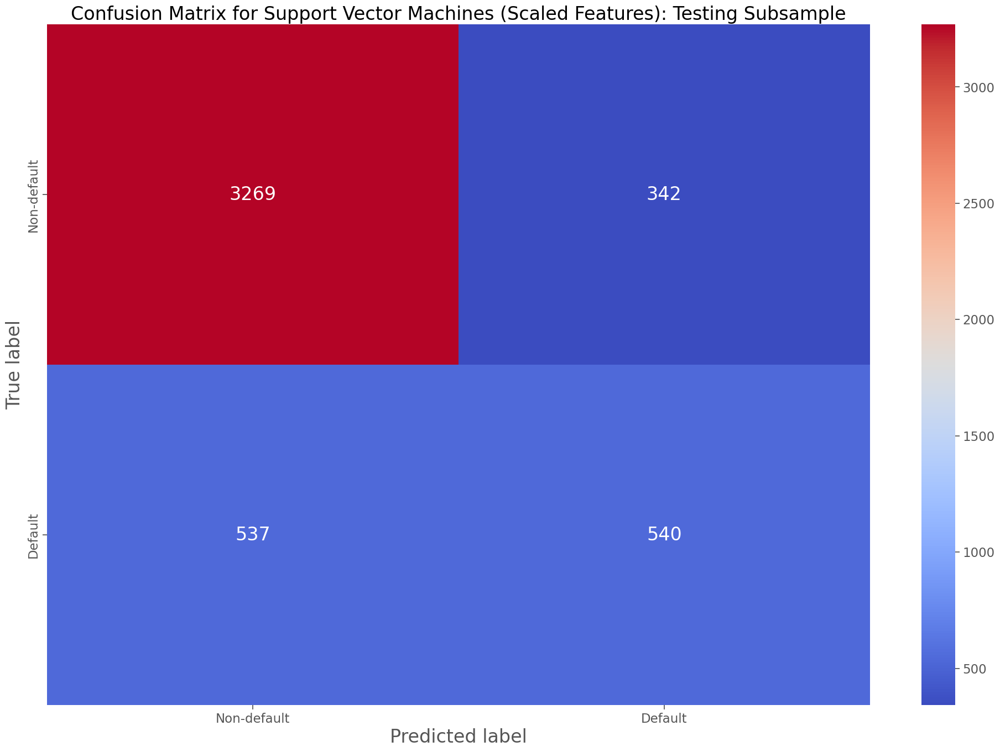

In [ ]:
# Plot the confusion matrix (testing subsample)
plt.figure(figsize=(24,16))
svc_ccd_confusion_scaled_test = confusion_matrix(y_scaled_test,calibrated_lsvc.predict_proba(X_scaled_test)[:, 1] >= optimal_threshold_test)
sns.heatmap(svc_ccd_confusion_scaled_test,
            annot=True,
            annot_kws={'size':24},
            cmap='coolwarm',
            fmt='d',
            xticklabels = ['Non-default', 'Default'],
            yticklabels = ['Non-default', 'Default'])
plt.ylabel('True label', size=24)
plt.xlabel('Predicted label', size=24)
plt.title('Confusion Matrix for Support Vector Machines (Scaled Features): Testing Subsample', size=24)
plt.show()

####K-Nearest Neighbors

In [ ]:
# Define the cross-validation approach
n_cv_knn = 5

# Define the maximum number of iterations
n_max_iter = 2000

# Create an instance of the class KNN model
knn_model = KNeighborsClassifier()

# Define the search space for the hyperparameters
search_space = dict()
search_space['n_neighbors'] = [2, 4, 6, 8, 10]
search_space['metric']      = ['euclidean', 'manhattan']

# Create an instance of the class GridSearchCV with desired characteristics
knn_grid_search_cv_scaled = GridSearchCV(estimator=knn_model,
                                         param_grid=search_space,
                                         scoring='accuracy',
                                         cv=n_cv_knn,
                                         n_jobs=-1
                                        )

# Run the search algorithm and summarize resuts
knn_grid_search_cv_scaled.fit(X_scaled_train.values, y_scaled_train.values)

print(f'Best score: {knn_grid_search_cv_scaled.best_score_:.4f}')
print('Best hyperparameters: %s' % knn_grid_search_cv_scaled.best_params_)

Best score: 0.8035
Best hyperparameters: {'metric': 'euclidean', 'n_neighbors': 10}


#####Predictions using KNeighborsClassifier

In [ ]:
# Create an instance of the class KNeighborsClassifier with specific selection of hyperparameters
knn_ccd_scaled = KNeighborsClassifier(n_neighbors=knn_grid_search_cv_scaled.best_params_['n_neighbors'],
                                      metric=knn_grid_search_cv_scaled.best_params_['metric'])

# Fit the model
knn_ccd_scaled.fit(X_scaled_train.values, y_scaled_train.values)

# Predict outcomes in the testing subsample and calculate accuracy
y_scaled_pred_knn_train = knn_ccd_scaled.predict_proba(X_scaled_train.values)[:, 1] >= optimal_threshold_train
y_scaled_pred_knn_test = knn_ccd_scaled.predict_proba(X_scaled_test.values)[:, 1] >= optimal_threshold_test
print(f'Accuracy: {metrics.accuracy_score(y_scaled_pred_knn_test,y_scaled_test):.4f}')

# Display cross-validation scores for the testing subsample
print(classification_report(y_scaled_train, y_scaled_pred_knn_train))
print(classification_report(y_scaled_test, y_scaled_pred_knn_test))

Accuracy: 0.7888
              precision    recall  f1-score   support

           0       0.88      0.87      0.88     14443
           1       0.59      0.61      0.60      4308

    accuracy                           0.81     18751
   macro avg       0.74      0.74      0.74     18751
weighted avg       0.82      0.81      0.81     18751

              precision    recall  f1-score   support

           0       0.86      0.86      0.86      3611
           1       0.54      0.53      0.54      1077

    accuracy                           0.79      4688
   macro avg       0.70      0.70      0.70      4688
weighted avg       0.79      0.79      0.79      4688



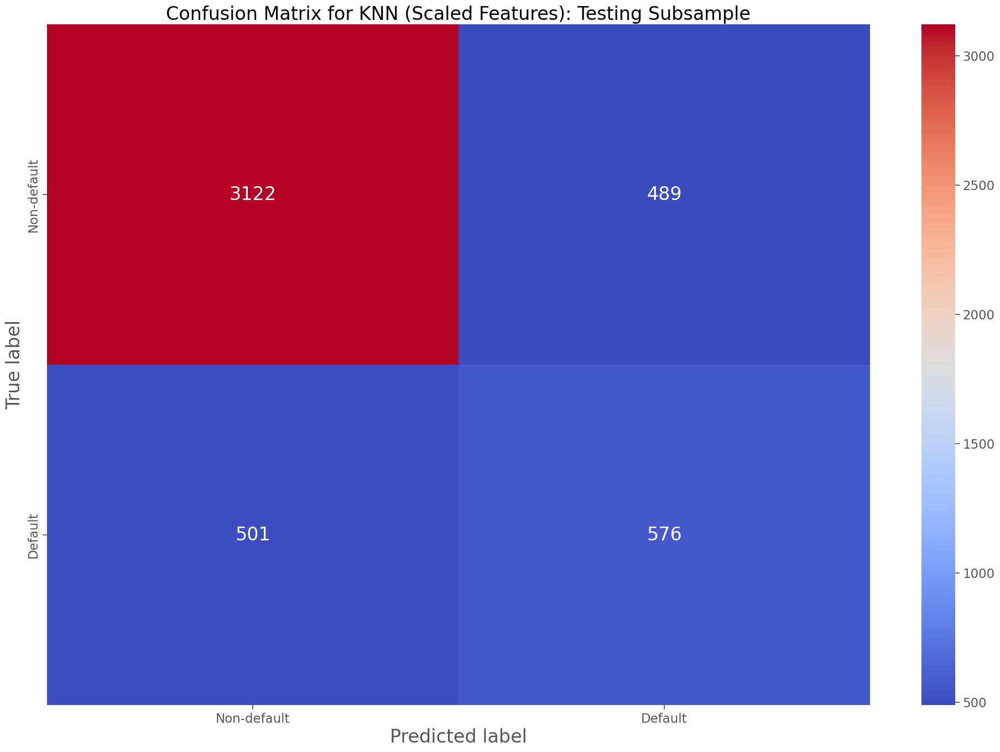

In [ ]:
# Plot the confusion matrix (testing subsample)
plt.figure(figsize=(24,16))
knn_ccd_confusion_scaled_test = confusion_matrix(y_scaled_test,knn_ccd_scaled.predict_proba(X_scaled_test.values)[:, 1] >= optimal_threshold_test)
sns.heatmap(knn_ccd_confusion_scaled_test,
            annot=True,
            annot_kws={'size':24},
            cmap='coolwarm',
            fmt='d',
            xticklabels = ['Non-default', 'Default'],
            yticklabels = ['Non-default', 'Default'])
plt.ylabel('True label', size=24)
plt.xlabel('Predicted label', size=24)
plt.title('Confusion Matrix for KNN (Scaled Features): Testing Subsample', size=24)
plt.show()

####Decision Trees

In [ ]:
# Define the cross-validation approach
n_cv_dt = 5

# Create an instance of the class DecisionTreeClassifier
dt_model = DecisionTreeClassifier()

# Define the search space for the hyperparameters
search_space = dict()
search_space['max_depth']        = [2, 3, 4, 5, 6, 7]
search_space['max_features']     = [2, 3, 4, 5, 6, 7]
search_space['min_samples_leaf'] = [2, 3, 4, 5, 6, 7]
search_space['criterion']        = ['gini', 'entropy']

# Create an instance of the class RandomizedSearchCV with desired characteristics
dt_randomized_search_cv_scaled = RandomizedSearchCV(estimator=dt_model,
                                                    param_distributions=search_space,
                                                    scoring='accuracy',
                                                    cv=n_cv_dt,
                                                    n_jobs=-1)

# Run the search algorithm and summarize resuts
dt_randomized_search_cv_scaled.fit(X_scaled_train, y_scaled_train)

print(f'Best score: {dt_randomized_search_cv_scaled.best_score_:.4f}')
print('Best hyperparameters: %s' % dt_randomized_search_cv_scaled.best_params_)

Best score: 0.8125
Best hyperparameters: {'min_samples_leaf': 6, 'max_features': 6, 'max_depth': 7, 'criterion': 'gini'}


#####Predictions using Decision Trees

In [ ]:
# Create an instance of the class DecisionTreeClassifier with specific selection of hyperparameters
dt_ccd_scaled = DecisionTreeClassifier(max_depth=dt_randomized_search_cv_scaled.best_params_['max_depth'],
                                       max_features=dt_randomized_search_cv_scaled.best_params_['max_features'],
                                       min_samples_leaf=dt_randomized_search_cv_scaled.best_params_['min_samples_leaf'],
                                       criterion=dt_randomized_search_cv_scaled.best_params_['criterion'])

# Fit the model
dt_ccd_scaled.fit(X_scaled_train, y_scaled_train)

# Predict outcomes in the training and testing subsamples and calculate accuracy
y_scaled_pred_dt_train = dt_ccd_scaled.predict_proba(X_scaled_train.values)[:,1] >= optimal_threshold_train
print(f'Accuracy: {metrics.accuracy_score(y_scaled_pred_dt_train,y_scaled_train):.4f}')

y_scaled_pred_dt_test = dt_ccd_scaled.predict_proba(X_scaled_test.values)[:,1] >= optimal_threshold_test
print(f'Accuracy: {metrics.accuracy_score(y_scaled_pred_dt_test,y_scaled_test):.4f}')

# Calculate and display cross-validation scores for the training and testing subsamples
dt_cv_scores_scaled =cross_val_score(dt_ccd_scaled, X_scaled_train, y_scaled_train, cv=n_cv_dt)
print(f'Average CV score (+/- one standard deviation): {dt_cv_scores_scaled.mean():.4f} +/- {dt_cv_scores_scaled.std():.4f}')

print(classification_report(y_scaled_train, y_scaled_pred_dt_train))
print(classification_report(y_scaled_test, y_scaled_pred_dt_test))

Accuracy: 0.8236
Accuracy: 0.8189


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


Average CV score (+/- one standard deviation): 0.8013 +/- 0.0059
              precision    recall  f1-score   support

           0       0.87      0.91      0.89     14443
           1       0.64      0.53      0.58      4308

    accuracy                           0.82     18751
   macro avg       0.75      0.72      0.74     18751
weighted avg       0.82      0.82      0.82     18751

              precision    recall  f1-score   support

           0       0.86      0.92      0.89      3611
           1       0.64      0.49      0.55      1077

    accuracy                           0.82      4688
   macro avg       0.75      0.70      0.72      4688
weighted avg       0.81      0.82      0.81      4688



/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but DecisionTreeClassifier was fitted with feature names
  warnings.warn(


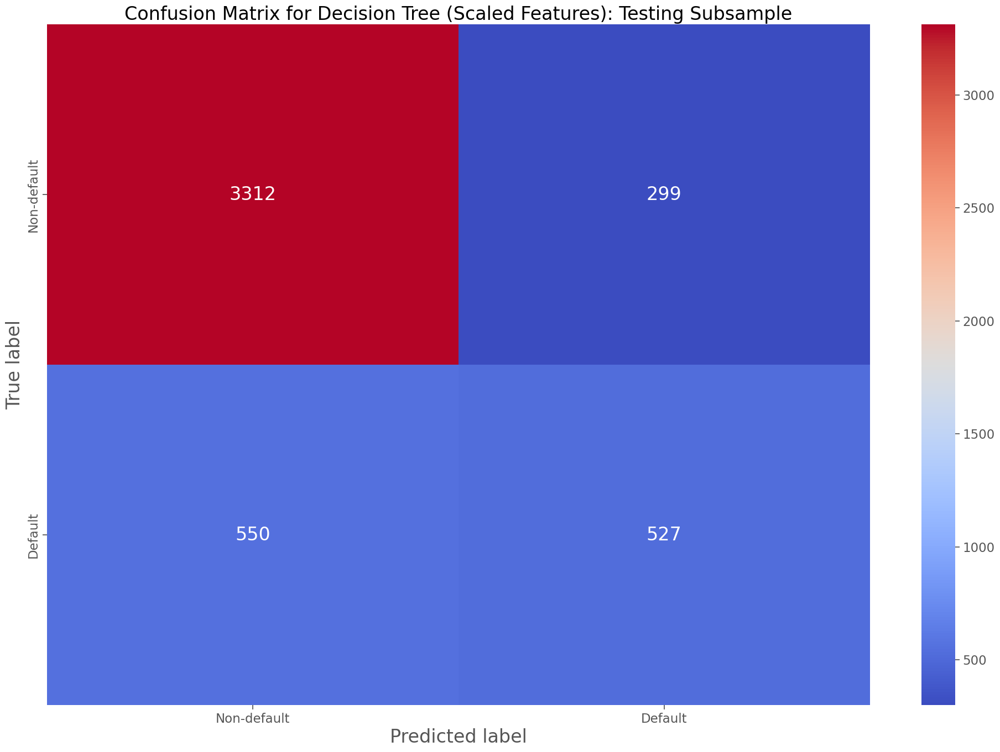

In [ ]:
# Plot the confusion matrix (testing subsample)
plt.figure(figsize=(24,16))
dt_ccd_confusion_scaled_test = confusion_matrix(y_scaled_test,dt_ccd_scaled.predict_proba(X_scaled_test.values)[:,1] >= optimal_threshold_test)
sns.heatmap(dt_ccd_confusion_scaled_test,
            annot=True,
            annot_kws={'size':24},
            cmap='coolwarm',
            fmt='d',
            xticklabels = ['Non-default', 'Default'],
            yticklabels = ['Non-default', 'Default'])
plt.ylabel('True label', size=24)
plt.xlabel('Predicted label', size=24)
plt.title('Confusion Matrix for Decision Tree (Scaled Features): Testing Subsample', size=24)
plt.show()

####Random Forest

In [ ]:
# Define the cross-validation approach
n_cv_rf = 5

# Create an instance of the class RandomForestClassifier
rf_model = RandomForestClassifier()

# Define the search space for the hyperparameters
search_space = dict()
search_space['n_estimators']     = [50, 100, 150, 200, 250]
search_space['max_depth']        = [2, 3, 4, 5, 6, 7]
search_space['max_features']     = [2, 3, 4, 5, 6, 7]
search_space['min_samples_leaf'] = [2, 3, 4, 5, 6, 7]
search_space['criterion']        = ['gini', 'entropy']

# Create an instance of the class RandomizedSearchCV with desired characteristics
rf_randomized_search_cv_scaled = RandomizedSearchCV(estimator=rf_model,
                                                    param_distributions=search_space,
                                                    scoring='accuracy',
                                                    cv=n_cv_rf,
                                                    n_jobs=-1)

# Run the search algorithm and summarize resuts
rf_randomized_search_cv_scaled.fit(X_scaled_train, y_scaled_train)

print(f'Best score: {rf_randomized_search_cv_scaled.best_score_:.4f}')
print('Best hyperparameters: %s' % rf_randomized_search_cv_scaled.best_params_)

Best score: 0.8202
Best hyperparameters: {'n_estimators': 200, 'min_samples_leaf': 2, 'max_features': 4, 'max_depth': 7, 'criterion': 'entropy'}


#####Predictions using Random Forest

In [ ]:
# Create an instance of the class RandomForestClassifier with specific selection of hyperparameters
rf_ccd_scaled = RandomForestClassifier(n_estimators=rf_randomized_search_cv_scaled.best_params_['n_estimators'],
                                       max_depth=rf_randomized_search_cv_scaled.best_params_['max_depth'],
                                       max_features=rf_randomized_search_cv_scaled.best_params_['max_features'],
                                       min_samples_leaf=rf_randomized_search_cv_scaled.best_params_['min_samples_leaf'],
                                       criterion=rf_randomized_search_cv_scaled.best_params_['criterion'])

# Fit the model
rf_ccd_scaled.fit(X_scaled_train, y_scaled_train)

# Predict outcomes in the training and testing subsamples and calculate accuracy
y_scaled_pred_rf_train = rf_ccd_scaled.predict_proba(X_scaled_train.values)[:,1] >= optimal_threshold_train
print(f'Accuracy: {metrics.accuracy_score(y_scaled_pred_rf_train,y_scaled_train):.4f}')

y_scaled_pred_rf_test = rf_ccd_scaled.predict_proba(X_scaled_test.values)[:,1] >= optimal_threshold_test
print(f'Accuracy: {metrics.accuracy_score(y_scaled_pred_rf_test,y_scaled_test):.4f}')

# Calculate and display cross-validation scores for the training and testing subsamples
rf_cv_scores_scaled =cross_val_score(rf_ccd_scaled, X_scaled_train, y_scaled_train, cv=n_cv_rf)
print(f'Average CV score (+/- one standard deviation): {rf_cv_scores_scaled.mean():.4f} +/- {rf_cv_scores_scaled.std():.4f}')

print(classification_report(y_scaled_train, y_scaled_pred_rf_train))
print(classification_report(y_scaled_test, y_scaled_pred_rf_test))

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Accuracy: 0.8211
Accuracy: 0.8161


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


Average CV score (+/- one standard deviation): 0.8195 +/- 0.0031
              precision    recall  f1-score   support

           0       0.88      0.89      0.88     14443
           1       0.62      0.58      0.60      4308

    accuracy                           0.82     18751
   macro avg       0.75      0.74      0.74     18751
weighted avg       0.82      0.82      0.82     18751

              precision    recall  f1-score   support

           0       0.86      0.90      0.88      3611
           1       0.62      0.52      0.57      1077

    accuracy                           0.82      4688
   macro avg       0.74      0.71      0.73      4688
weighted avg       0.81      0.82      0.81      4688



In [ ]:
report = classification_report(y_scaled_test, y_scaled_pred_rf_test, target_names=['class 0', 'class 1'], output_dict=True)

precision_class_1 = report['class 1']['precision']
recall_class_1 = report['class 1']['recall']
f1_score_class_1 = report['class 1']['f1-score']
accuracy = report['accuracy']

print(f'Precision for class 1: {precision_class_1:.4f}')
print(f'Recall for class 1: {recall_class_1:.4f}')
print(f'F1-score for class 1: {f1_score_class_1:.4f}')
print(f'Accuracy: {accuracy:.4f}')

Precision for class 1: 0.6175
Recall for class 1: 0.5246
F1-score for class 1: 0.5673
Accuracy: 0.8161


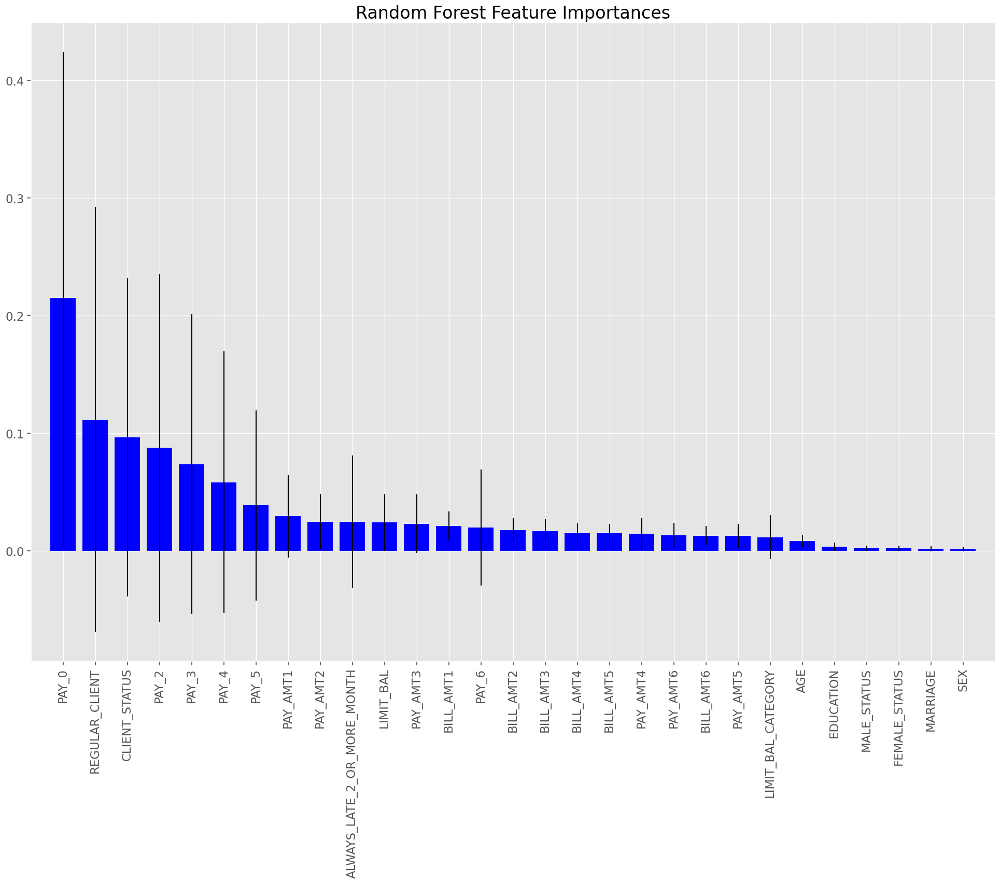

In [ ]:
# Extract importances
importances = rf_ccd_scaled.feature_importances_
std         = np.std([tree.feature_importances_ for tree in rf_ccd_scaled.estimators_],
                     axis=0)

ix_importances = np.argsort(importances)[::-1]

# Plot the feature importances for the random forest
plt.figure(figsize=(24, 16))
plt.bar(range(X_scaled_train.shape[1]),
        importances[ix_importances],
        color='b',
        yerr=std[ix_importances],
        align='center'
       )
plt.xticks(range(X_scaled_train.shape[1]),
           X_scaled_train.columns[ix_importances],
           rotation=90
          )
plt.xlim([-1, X_scaled_train.shape[1]])
plt.title('Random Forest Feature Importances', size=24)
plt.show()

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(


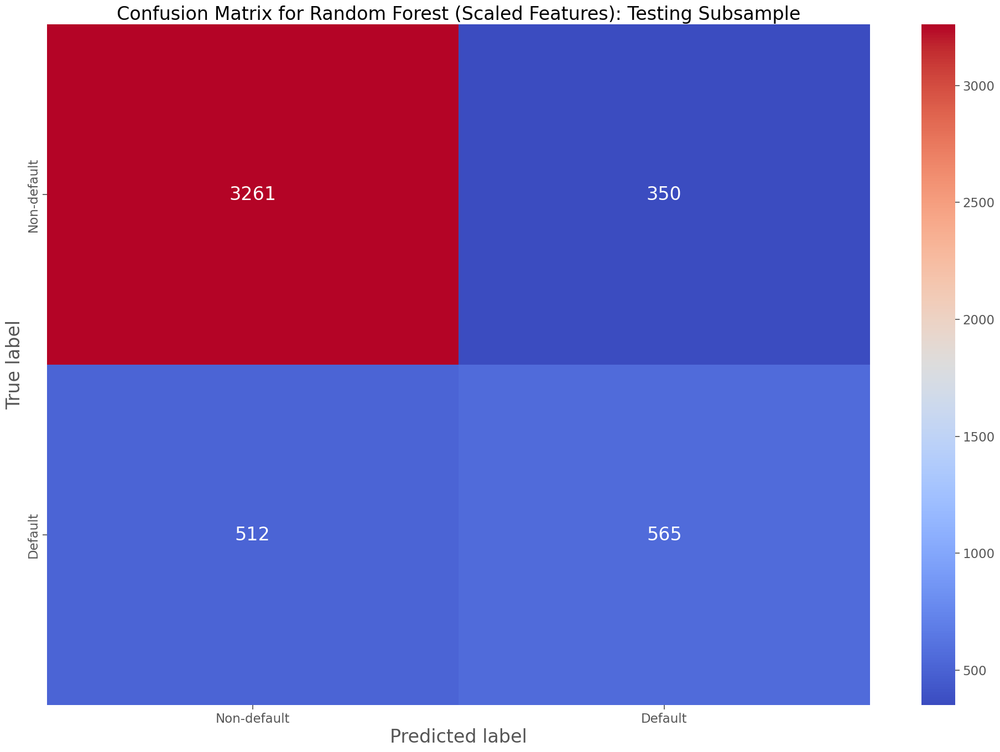

In [ ]:
# Plot the confusion matrix (testing subsample)
plt.figure(figsize=(24,16))
rf_ccd_confusion_scaled_test = confusion_matrix(y_scaled_test,rf_ccd_scaled.predict_proba(X_scaled_test.values)[:,1] >= optimal_threshold_test)
sns.heatmap(rf_ccd_confusion_scaled_test,
            annot=True,
            annot_kws={'size':24},
            cmap='coolwarm',
            fmt='d',
            xticklabels = ['Non-default', 'Default'],
            yticklabels = ['Non-default', 'Default']
           )
plt.ylabel('True label', size=24)
plt.xlabel('Predicted label', size=24)
plt.title('Confusion Matrix for Random Forest (Scaled Features): Testing Subsample', size=24)
plt.show()

##Comparison of models

In [ ]:
models = ['Decision Tree', 'KNN', 'Random Forest', 'Linear SVC', 'Logistic Regression']
predictions = [y_scaled_pred_dt_test, y_scaled_pred_knn_test, y_scaled_pred_rf_test, y_scaled_pred_test_svc, y_pred_test_optimal_pr]

results_df = pd.DataFrame(columns=['Model', 'Precision', 'Recall', 'F1-Score', 'Accuracy'])

for model, pred in zip(models, predictions):
    precision = precision_score(y_scaled_test, pred, pos_label=1)
    recall = recall_score(y_scaled_test, pred, pos_label=1)
    f1 = f1_score(y_scaled_test, pred, pos_label=1)
    accuracy = accuracy_score(y_scaled_test, pred)

    results_df = results_df.append({'Model': model, 'Precision': precision, 'Recall': recall, 'F1-Score': f1, 'Accuracy': accuracy}, ignore_index=True)

print(results_df)

                 Model  Precision    Recall  F1-Score  Accuracy
0        Decision Tree   0.638015  0.489322  0.553862  0.818899
1                  KNN   0.540845  0.534819  0.537815  0.788823
2        Random Forest   0.617486  0.524605  0.567269  0.816126
3           Linear SVC   0.612245  0.501393  0.551302  0.812500
4  Logistic Regression   0.585062  0.523677  0.552670  0.805247


<ipython-input-96-c41ab7d04064>:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'Model': model, 'Precision': precision, 'Recall': recall, 'F1-Score': f1, 'Accuracy': accuracy}, ignore_index=True)
<ipython-input-96-c41ab7d04064>:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'Model': model, 'Precision': precision, 'Recall': recall, 'F1-Score': f1, 'Accuracy': accuracy}, ignore_index=True)
<ipython-input-96-c41ab7d04064>:12: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  results_df = results_df.append({'Model': model, 'Precision': precision, 'Recall': recall, 'F1-Score': f1, 'Accuracy': accuracy}, ignore_index=True)
<ipython-input-96-c41ab7d04064>:12: FutureW

In [ ]:
results_df

,Model,Precision,Recall,F1-Score,Accuracy
0,Decision Tree,0.638015,0.489322,0.553862,0.818899
1,KNN,0.540845,0.534819,0.537815,0.788823
2,Random Forest,0.617486,0.524605,0.567269,0.816126
3,Linear SVC,0.612245,0.501393,0.551302,0.812500
4,Logistic Regression,0.434857,0.706592,0.538380,0.721630


**I we could use F1 score for benchmark for all models, we could say that Random Forest classifier have the best performance on Testing subsample.Per confusion matrix, and looking explicitly at predicting TRUE(default) class, Logistic Regression does by far the best job predicting which observation falls into TRUE(default) class, which is also represented with recall metric value.**
